# Detección automática de cianobacterias mediante espectroscopía Raman
## Preprocesado de los datos espectroscópicos
### 1. Carga paquetes

In [1]:
from PIL import Image
import numpy as np
import pandas as pd
import re
import os
import math
import joblib
import warnings
import time
import matplotlib.pyplot as plt
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler, MinMaxScaler, LabelEncoder, Normalizer
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, roc_curve, classification_report
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score, roc_auc_score
from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN, SpectralClustering, Birch
from sklearn.decomposition import PCA
from scipy.linalg import solveh_banded  # para hacer ALS
from scipy import sparse
from scipy.sparse.linalg import spsolve
from scipy.signal import argrelextrema
from itertools import product
from scipy.signal import savgol_filter
from sklearn.preprocessing import StandardScaler, MinMaxScaler, LabelEncoder, Normalizer
from scipy.linalg import solveh_banded  # para hacer ALS
from scipy import sparse
from scipy.sparse.linalg import spsolve
from scipy.signal import argrelextrema
from itertools import product
from scipy.signal import savgol_filter
from functools import reduce
from sklearn.metrics import mean_squared_error as mse

Se automatiza el proceso para conocer la cantidad de datos buenos que tenememos en cada archivo

In [2]:
# Metemos todo el preprocesado de nobita
class WhittakerSmoother(object):
  def __init__(self, signal, smoothness_param, deriv_order=1):
    self.y = signal
    assert deriv_order > 0, 'deriv_order must be an int > 0'
    # Compute the fixed derivative of identity (D).
    d = np.zeros(deriv_order*2 + 1, dtype=int)
    d[deriv_order] = 1
    d = np.diff(d, n=
    deriv_order)
    n = self.y.shape[0]
    k = len(d)
    s = float(smoothness_param)
    # Here be dragons: essentially we're faking a big banded matrix D,
    # doing s * D.T.dot(D) with it, then taking the upper triangular bands.
    diag_sums = np.vstack([
        np.pad(s*np.cumsum(d[-i:]*d[:i]), ((k-i,0),), 'constant')
        for i in range(1, k+1)])
    upper_bands = np.tile(diag_sums[:,-1:], n)
    upper_bands[:,:k] = diag_sums
    for i,ds in enumerate(diag_sums):
      upper_bands[i,-i-1:] = ds[::-1][:i+1]
    self.upper_bands = upper_bands
  def smooth(self, w):
    foo = self.upper_bands.copy()
    foo[-1] += w  # last row is the diagonal
    return solveh_banded(foo, w * self.y, overwrite_ab=True, overwrite_b=True)


def als_baseline(intensities, asymmetry_param=0.0001, smoothness_param=1e4,
                 max_iters=40, conv_thresh=1e-6, verbose=False):
    """
    Applies the asymmetric least squares (ALS) method to fit the baseline.

    Parameters:
    - intensities (numpy.ndarray or pandas.Series): Numpy array or pandas Series representing the Raman intensities.
    - asymmetry_param (float): Asymmetry parameter for the fit.
    - smoothness_param (float): Smoothness parameter for the fit.
    - max_iters (int): Maximum number of iterations.
    - conv_thresh (float): Convergence threshold.
    - verbose (bool): Flag to print debugging information.

    Returns:
    - baseline (numpy.ndarray): Numpy array representing the fitted baseline.
    """
    if isinstance(intensities, pd.Series):
        intensities = intensities.values

    smoother = WhittakerSmoother(intensities, smoothness_param, deriv_order=2)
    p = asymmetry_param
    w = np.ones(intensities.shape[0])

    for i in range(max_iters):
        z = smoother.smooth(w)
        mask = intensities > z
        new_w = p * mask + (1 - p) * (~mask)
        conv = np.linalg.norm(new_w - w)

        if verbose:
            print(i + 1, conv)

        if conv < conv_thresh:
            break

        w = new_w
    else:
        print('ALS did not converge in %d iterations' % max_iters)

    return z

In [3]:
def find_baseline(df):
    """
    Apply baseline correction to each row in a DataFrame.
    Input:
        df: DataFrame, contains the spectral data.
    Output:
        DataFrame, with baseline corrected for each spectrum.
    """
    D0_BL = df.copy()
    for i in range(len(df)):
        # Apply ALS baseline correction to each row
        bl = als_baseline(df.iloc[i, :].values)
        D0_BL.iloc[i, :] = bl
    return D0_BL


def correct_baseline(data, baseline):
    """
    Corrects the baseline of the data.
    Parameters:
    - data (pandas.DataFrame or pandas.Series): DataFrame or Series containing the data.
    - baseline (pandas.DataFrame or pandas.Series): DataFrame or Series with the baselines.
    Returns:
    - corrected_data (pandas.DataFrame): DataFrame with the corrected data.
    """
    # Ensure that both data and baseline are DataFrames
    if not isinstance(data, pd.DataFrame):
        data = pd.DataFrame(data)

    if not isinstance(baseline, pd.DataFrame):
        baseline = pd.DataFrame(baseline)

    # Perform baseline correction
    corrected_data = data.values - baseline.values

    # Convert the result back to a DataFrame while maintaining the same column names
    corrected_data = pd.DataFrame(corrected_data, columns=data.columns).copy()

    return corrected_data


def normalize_spectra(X_filtered, number):
    """
    Preprocessing of spectral data.
    Input:
        X_filtered: DataFrame, raw spectral data.
    Output:
        DataFrame, preprocessed spectral data.
    """
    if number == 1: # Normaliza por espectro
    
        X_norm_list = []
        for _, row in X_filtered.iterrows():
            # Normalize each spectrum by dividing by the sum and multiplying by a constant
            total = np.sum(row)
            X_norm_list.append(pd.DataFrame([row / total * 2000]))

        X_norm = pd.concat(X_norm_list, ignore_index=True)

        # Apply Savitzky-Golay filter for smoothing
        X_norm_flt = savgol_filter(X_norm, 21, 2)
        X_norm_flt = pd.DataFrame(X_norm_flt, columns=X_filtered.columns)

        '''# Perform baseline correction
        bl = find_baseline(X_norm_flt)
        X_norm_flt = X_norm_flt - bl'''
    if number == 0: #  Normaliza todo
        # Normalize the data using StandardScaler
        scaler = StandardScaler()
        X_norm_flt = pd.DataFrame(scaler.fit_transform(X_filtered.T).T, columns=X_filtered.columns)
    # Standardize the data using StandardScaler
    scaler = StandardScaler()
    z_numpy = X_norm_flt.values
    z_numpy_scaled_rows = scaler.fit_transform(z_numpy.T).T
    X_norm_flt_stdz = pd.DataFrame(data=z_numpy_scaled_rows, columns=X_filtered.columns)

    return X_norm_flt_stdz


In [4]:
def procesarRaman_carpeta(ruta, normalizado):
    """
    Process Raman spectra data from a folder.

    Args:
        ruta (str): The path to the folder containing the Raman spectra data files.

    Returns:
        list: A list of tuples containing the processed data for each file. Each tuple contains:
            - The file name
            - The coordinates
            - The raw Raman spectra data
            - The baseline-corrected Raman spectra data
            - The preprocessed Raman spectra data
            - The Raman shift values
    """
    
    import os

    archivos_csv = [archivo for archivo in os.listdir(ruta) if archivo.lower().endswith('.csv')]

    print('esto el que hay en ', archivos_csv)
    archivos_csv.sort()

    resultados = []
    
    for archivo in archivos_csv:
        # Read the CSV file
        print(f'Procesando {archivo}...')
        df = pd.read_csv(os.path.join(ruta, archivo), engine='python', sep=',', skiprows=14, decimal='.')

        # Drop unwanted column
        if 'Unnamed: 1937' in df.columns:
            df = df.drop(columns=['Unnamed: 1937'])

        # Store coordinates
        coordenadas = df.iloc[:, 0:2].T
        
        # Select only ramanshift columns
        df2 = df.iloc[:, 7:]

        # Create a DataFrame for Raman shift values
        ramanshitfs = pd.DataFrame(df2.columns.astype(float), columns=['Raman shift'])

        # Select Raman spectra data within the desired range
        D = df2.loc[:, (df2.columns.astype(float) >= 600.0) & (df2.columns.astype(float) <= 1800.0)]

        # Filter Raman shift values within the desired range
        ramanshitfs = ramanshitfs.loc[(ramanshitfs['Raman shift'] >= 600) & (ramanshitfs['Raman shift'] <= 1800)]


        #Filtrado de espectros saturados
        # guardado del número total de filas
        total_rows = len(D)
        # indices de las filas que contienen valores superiores a 65000
        indices = D.index[D.gt(65000).any(1)]
        # Descartar las filas donde cualquier valor supera 65000
        D = D[~(D > 65000).any(axis=1)]
        # Nos cargamos las coordenadas de las filas descartadas
        coordenadas = coordenadas.drop(indices, axis=1)
        # Guardar el número de filas después de descartar
        remaining_rows = len(D)
        # Calcular e imprimir el número de filas descartadas
        discarded_rows = total_rows - remaining_rows
        print(f'{archivo}: se descartaron {discarded_rows} espectros saturados de un total de {total_rows} espectros.')
    
        
        # Find baseline of Raman spectra data
        D_BL = find_baseline(D)

        # Correct baseline of Raman spectra data
        D_BC = correct_baseline(D, D_BL)
        
        # Normalize Raman spectra data
        
        if normalizado.lower() == 'si':
            D_PP = normalize_spectra(D_BC, number)
        else:
            D_PP = D_BC
        
    
        # Append processed data to the results list
        resultados.append((archivo, coordenadas, D, D_BL,D_BC, D_PP, ramanshitfs))

    return resultados

In [5]:
def valida(head, centro):
    N=len(head)
    validas=[]
    extremoIzqda = centro - 50
    extremoDcha = centro + 50
    for i in range(N):
        valor = float(head[i])
        if valor > extremoIzqda and valor < extremoDcha:
            validas.append(i)
    return validas

def SNR(ruta, normalizado, histograma, mapa_calor):
    resultados = procesarRaman_carpeta(ruta, normalizado)
    # La coordenada Y esta girada, por tanto la debemos invertir
    resultados[0][1].loc['Y'] = resultados[0][1].loc['Y']*-1
    head_ruido = valida(resultados[0][5].columns, 650)
    head_signal = valida(resultados[0][5].columns, 1000)
    ruido = resultados[0][5].iloc[:, head_ruido]
    signal = resultados[0][5].iloc[:, head_signal]
    maximo = signal.max(axis=1)
    std_ruido = ruido.std(axis=1)
    relacion = maximo / std_ruido

    if histograma.lower() == 'si':
        plt.hist(relacion, bins=100)
        plt.title('A_max / std_noise')
        plt.show()

    grupo15 = relacion[relacion>15]

    # Asegúrate de que grupo15.index es una lista de índices
    grupo15_index = grupo15.index

    # Filtrar los índices de grupo14_index que no están en las columnas de resultados[0][1]
    filtered_index = [idx for idx in grupo15_index if idx in resultados[0][1].columns]

    # Obtener el DataFrame con los índices filtrados
    rel15 = resultados[0][1].loc[:, filtered_index]
    n= len(filtered_index)
    
    
    if mapa_calor.lower() == 'si':
        plt.scatter(rel15.loc['X'], rel15.loc['Y'], color='red', marker='s')
        
        plt.title('Mapa de calor SNR')
        plt.show()

    # Directory path
    
    directory_path = ruta
    # Search for a file that contains 'PRE' in its name
    image_file = None
    for file in os.listdir(directory_path):
        if 'PRE' in file and (file.endswith('.png') or file.endswith('.jpg') or file.endswith('.jpeg')):
            image_file = os.path.join(directory_path, file)
            break

    # Check if the image file was found
    if image_file:
        # Open the image file
        image = Image.open(image_file)
        
        # Display the image
        plt.imshow(image)
        plt.axis('off')  # Hide the axis
        plt.show()
    else:
        print("No image file containing 'PRE' found in the specified directory.")

    
    snr = resultados[0][5].iloc[filtered_index, :]
    

    snr_norm = normalize_spectra(snr, 1)
    
    head= resultados[0][5].columns
    
    # head pero solo de 50 en 50
    ramanshifts = pd.DataFrame(resultados[0][2].columns[:].astype(float))
    
    
    
    for i in range(len(snr_norm)):
        plt.plot(ramanshifts, snr_norm.iloc[i, :])
        plt.xlabel('Raman shift (cm$^{-1}$)', fontsize = 12)
        plt.ylabel('Intensity (a.u.)', fontsize=12)
        
        plt.xlim([600, 1800])
    plt.show()

    sol=[snr_norm,  n, relacion, resultados[0][1] ,grupo15, rel15,filtered_index, resultados[0][5]]
    return sol

### 2. Carga archivos

In [6]:
# Rutas de los archivos
ruta = r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM588\140323_UAM588_individual_2s_1acc_pwmuesca2_3um"
ruta2= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM588\140323_UAM588_individual_2s_1acc_pwmuesca2_4um"
ruta3= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM588\150324_UAM588_individuales_2s_1acc_pwmuesca2_4um"
ruta4= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM588\150324_UAM588_individuales_300ms_1acc_pwras_5um_2"
ruta5= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM588\150324_UAM588_individuales_300ms_1acc_pwras_5um_3"
ruta6= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM588\150324_UAM588_individuales_500ms_1acc_pwmuesca1_4um"
ruta7= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM588\150324_UAM588_individuales_500ms_1acc_pwmuesca1_4um_2"
ruta8= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM588\150324_UAM588_individuales_500ms_1acc_pwmuesca1_4um_3"
ruta9= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM588\180324_UAM588_300ms_1acc_pwras_7um_1"
ruta10= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM588\180324_UAM588_planoabajo_300ms_1acc_pwras_7um"
ruta11= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM588\180324_UAM588_planoabajo_500ms_1acc_pwmuesca1_7um_1"
ruta12= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM588\180324_UAM588_planosuperior_300ms_1acc_pwras_5um"
ruta13= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM588\180324_UAM588_planosuperior_300ms_1acc_pwras_20um"
ruta14= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM588\180324_UAM588_planosuperior_300ms_1acc_pwras_20um"
ruta15= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM588\190324_UAM588_restos_planoabajo_300ms_1acc_pwras_6um"
ruta16= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM588\190324_UAM588_restos_planoarriba_300ms_1acc_pwras_6um"
ruta17= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM588\200323_UAM588_planoarriba_1s_1acc_pwmuesca1_5um"

esto el que hay en  ['140323_UAM588_individual_2s_1acc_pwmuesca2_3um.csv']
Procesando 140323_UAM588_individual_2s_1acc_pwmuesca2_3um.csv...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


140323_UAM588_individual_2s_1acc_pwmuesca2_3um.csv: se descartaron 0 espectros saturados de un total de 432 espectros.


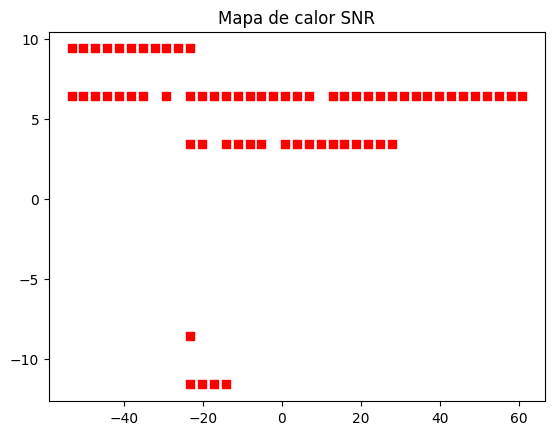

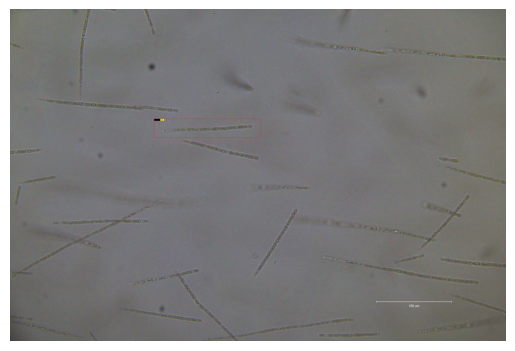

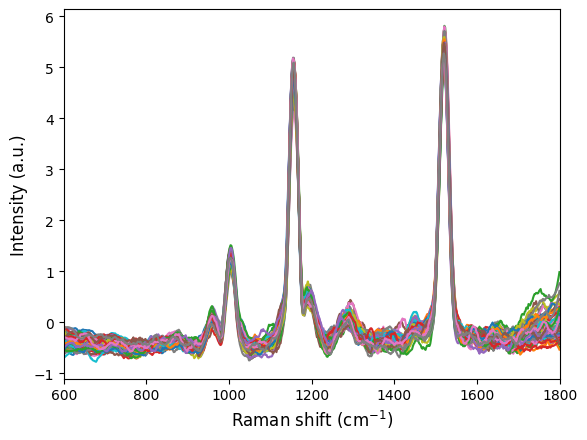

In [7]:
carpeta1= SNR(ruta, 'no', 'no', 'si')

esto el que hay en  ['140323_UAM588_individual_2s_1acc_pwmuesca2_4um.csv']
Procesando 140323_UAM588_individual_2s_1acc_pwmuesca2_4um.csv...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


140323_UAM588_individual_2s_1acc_pwmuesca2_4um.csv: se descartaron 0 espectros saturados de un total de 259 espectros.


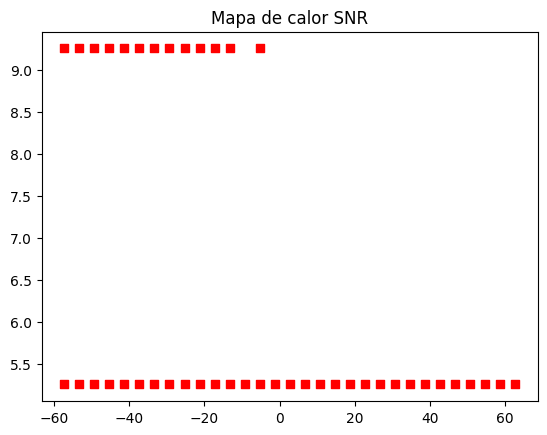

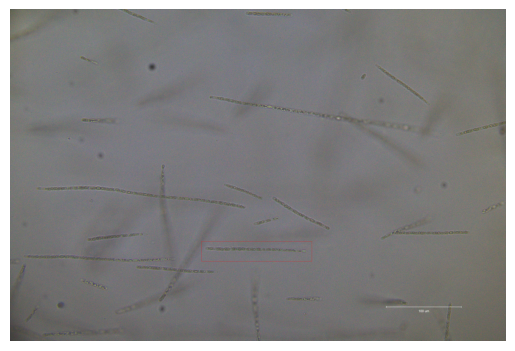

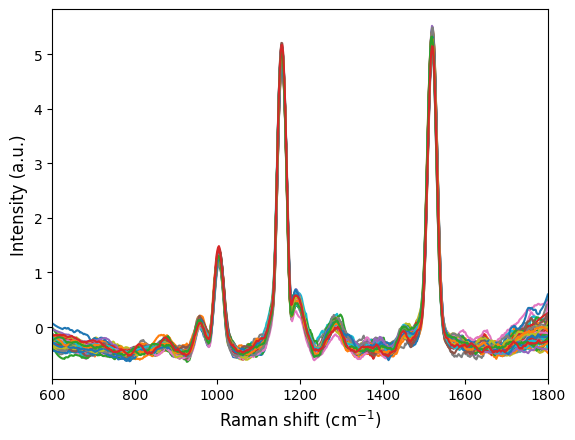

In [8]:
carpeta2= SNR(ruta2, 'no', 'no', 'si')

esto el que hay en  ['150324_UAM588_individuales_2s_1acc_pwmuesca2_4um.CSV']
Procesando 150324_UAM588_individuales_2s_1acc_pwmuesca2_4um.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


150324_UAM588_individuales_2s_1acc_pwmuesca2_4um.CSV: se descartaron 0 espectros saturados de un total de 540 espectros.


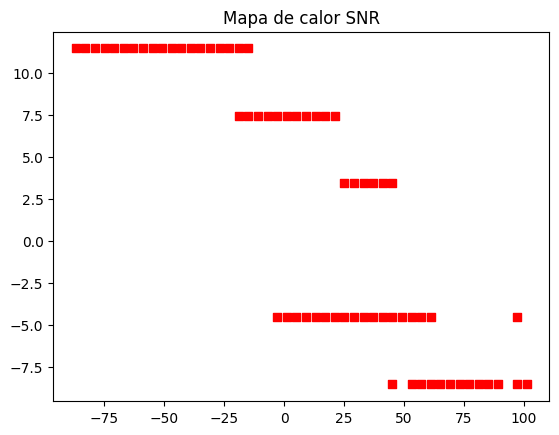

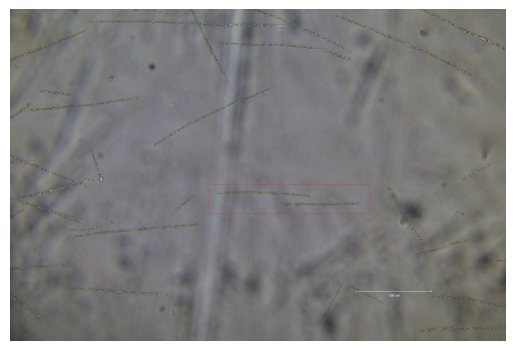

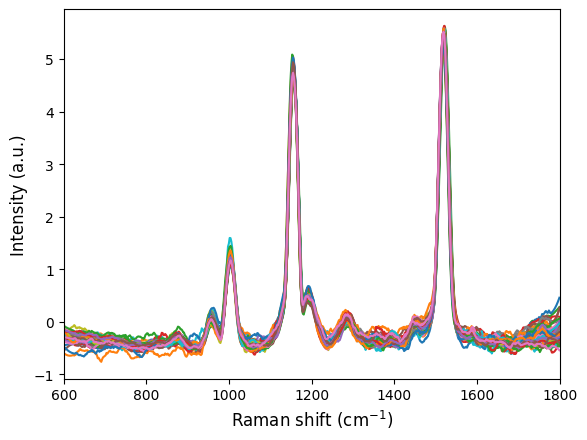

In [9]:
carpeta3= SNR(ruta3, 'no', 'no', 'si')

esto el que hay en  ['150324_UAM588_individuales_300ms_1acc_pwras_5um_2.CSV']
Procesando 150324_UAM588_individuales_300ms_1acc_pwras_5um_2.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


150324_UAM588_individuales_300ms_1acc_pwras_5um_2.CSV: se descartaron 26 espectros saturados de un total de 1683 espectros.


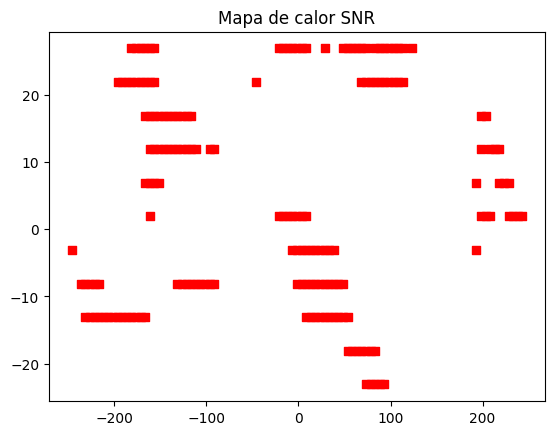

No image file containing 'PRE' found in the specified directory.


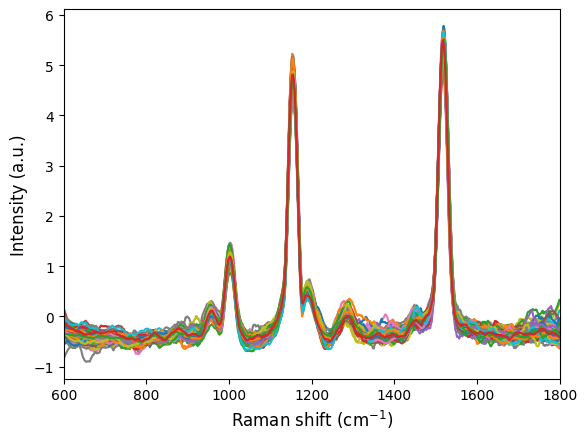

In [10]:
carpeta4= SNR(ruta4, 'no', 'no', 'si')

esto el que hay en  ['150324_UAM588_individuales_300ms_1acc_pwras_5um_3.CSV']
Procesando 150324_UAM588_individuales_300ms_1acc_pwras_5um_3.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


150324_UAM588_individuales_300ms_1acc_pwras_5um_3.CSV: se descartaron 13 espectros saturados de un total de 3234 espectros.


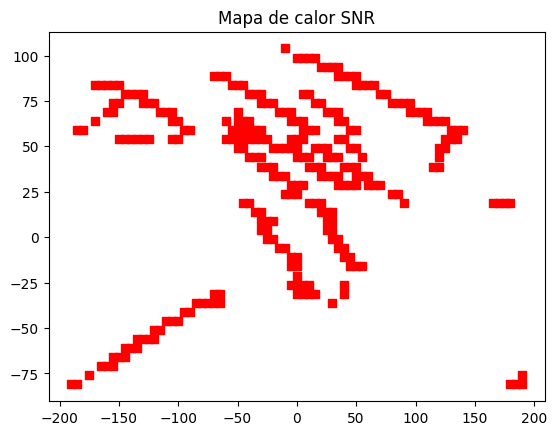

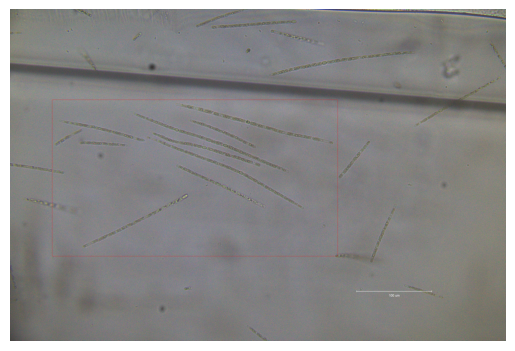

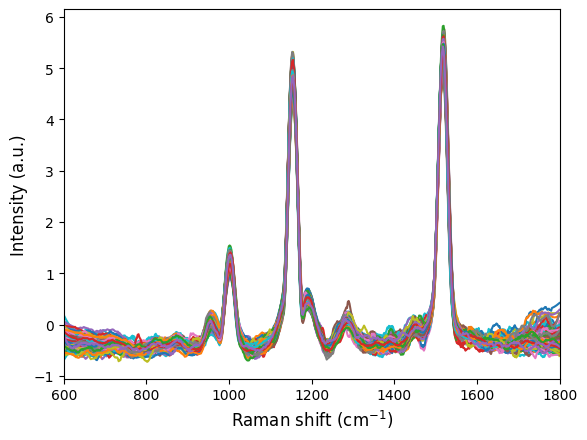

In [11]:
carpeta5= SNR(ruta5, 'no', 'no', 'si')

esto el que hay en  ['150324_UAM588_individuales_500ms_1acc_pwmuesca1_4um.CSV']
Procesando 150324_UAM588_individuales_500ms_1acc_pwmuesca1_4um.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


150324_UAM588_individuales_500ms_1acc_pwmuesca1_4um.CSV: se descartaron 1 espectros saturados de un total de 224 espectros.


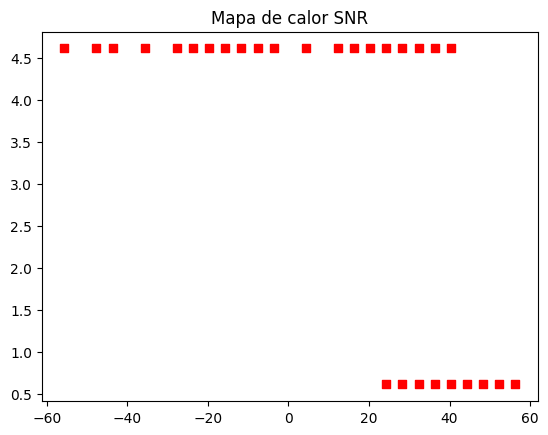

No image file containing 'PRE' found in the specified directory.


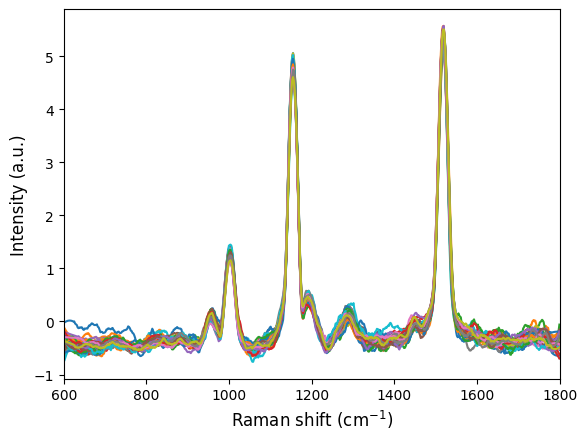

In [12]:
carpeta6= SNR(ruta6, 'no', 'no', 'si')

esto el que hay en  ['150324_UAM588_individuales_500ms_1acc_pwmuesca1_4um_2.CSV']
Procesando 150324_UAM588_individuales_500ms_1acc_pwmuesca1_4um_2.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


150324_UAM588_individuales_500ms_1acc_pwmuesca1_4um_2.CSV: se descartaron 6 espectros saturados de un total de 576 espectros.


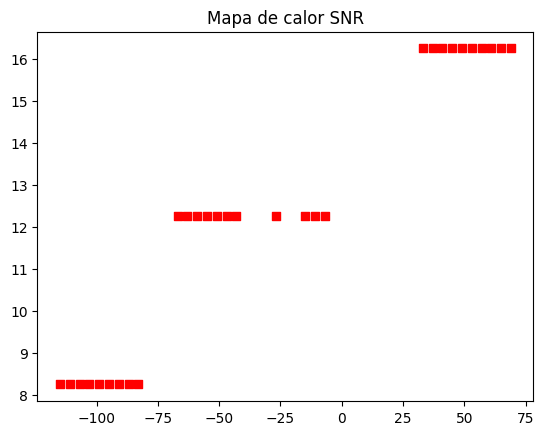

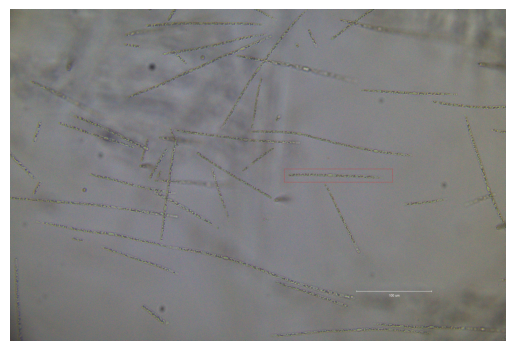

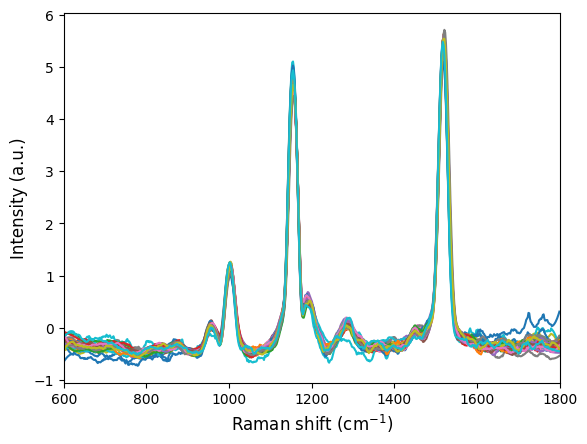

In [13]:
carpeta7= SNR(ruta7, 'no', 'no', 'si')

esto el que hay en  ['150324_UAM588_individuales_500ms_1acc_pwmuesca1_4um_3.CSV']
Procesando 150324_UAM588_individuales_500ms_1acc_pwmuesca1_4um_3.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


150324_UAM588_individuales_500ms_1acc_pwmuesca1_4um_3.CSV: se descartaron 4 espectros saturados de un total de 448 espectros.


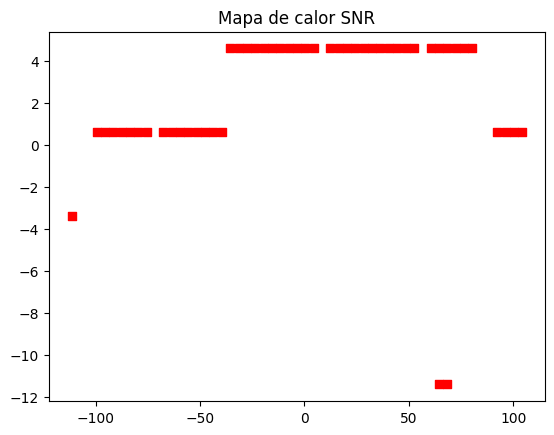

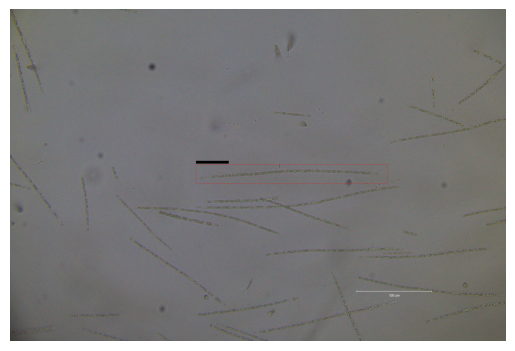

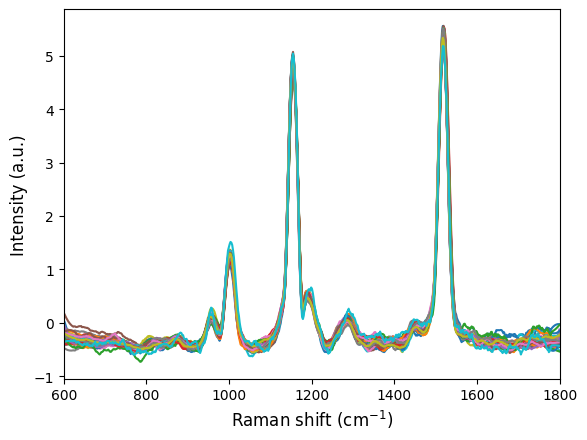

In [14]:
carpeta8= SNR(ruta8, 'no', 'no', 'si')


esto el que hay en  ['180324_UAM588_300ms_1acc_pwras_7um_1.CSV']
Procesando 180324_UAM588_300ms_1acc_pwras_7um_1.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


180324_UAM588_300ms_1acc_pwras_7um_1.CSV: se descartaron 7 espectros saturados de un total de 1620 espectros.


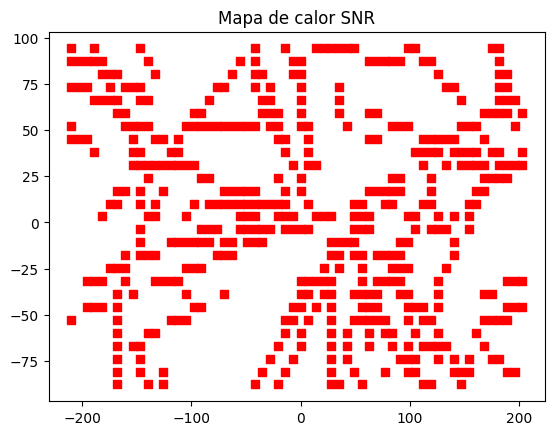

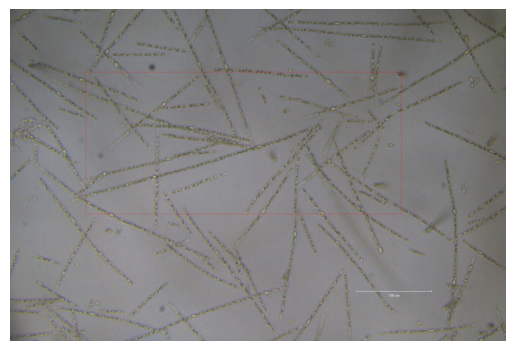

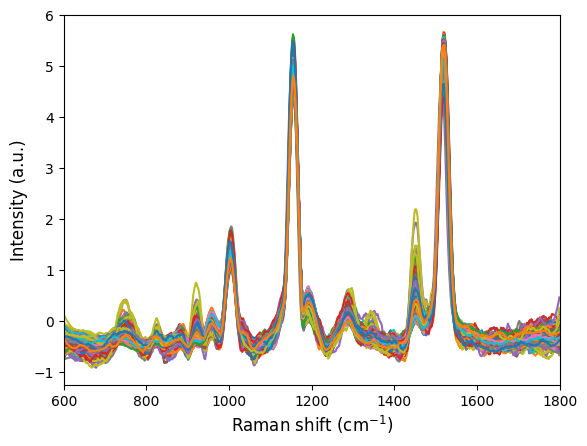

In [15]:
carpeta9= SNR(ruta9, 'no', 'no', 'si')

esto el que hay en  ['180324_UAM588_planoabajo_300ms_1acc_pwras_7um.CSV']
Procesando 180324_UAM588_planoabajo_300ms_1acc_pwras_7um.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


180324_UAM588_planoabajo_300ms_1acc_pwras_7um.CSV: se descartaron 2 espectros saturados de un total de 2788 espectros.


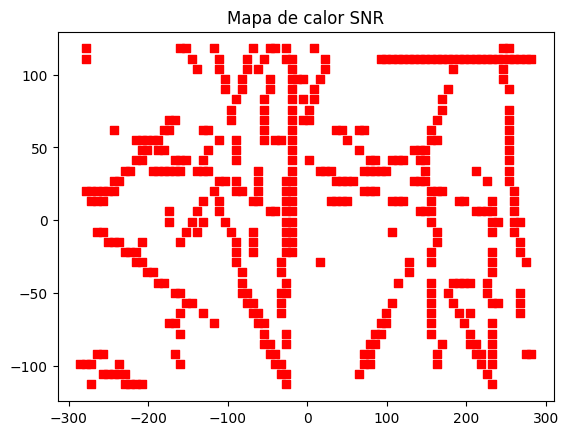

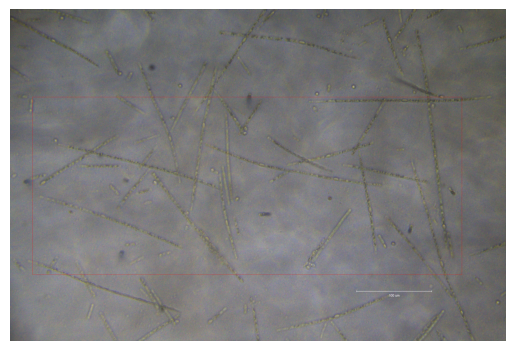

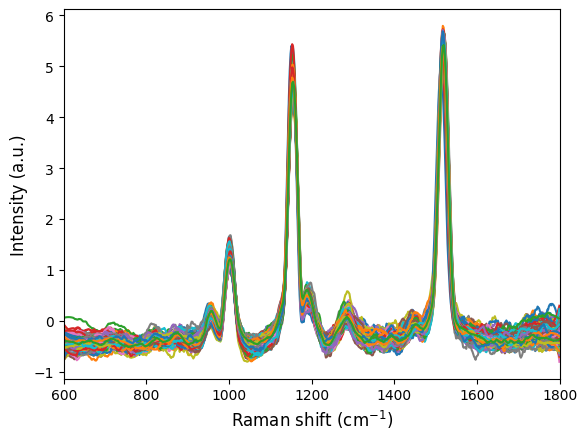

In [16]:
carpeta10= SNR(ruta10, 'no', 'no', 'si')

esto el que hay en  ['180324_UAM588_planoabajo_500ms_1acc_pwmuesca1_7um_1.CSV']
Procesando 180324_UAM588_planoabajo_500ms_1acc_pwmuesca1_7um_1.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


180324_UAM588_planoabajo_500ms_1acc_pwmuesca1_7um_1.CSV: se descartaron 0 espectros saturados de un total de 2788 espectros.


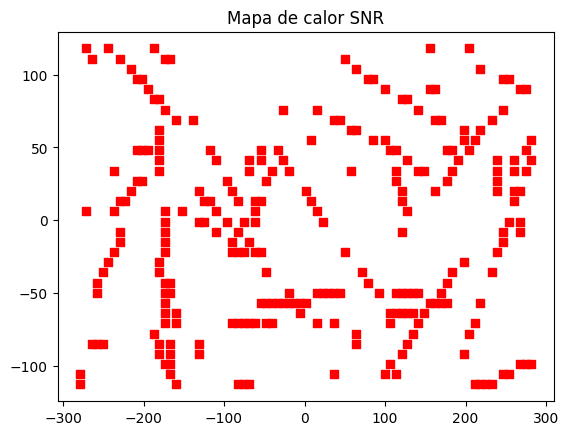

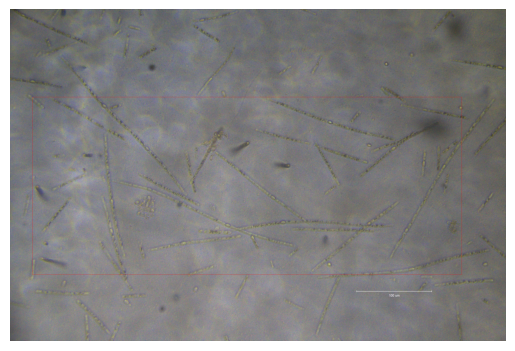

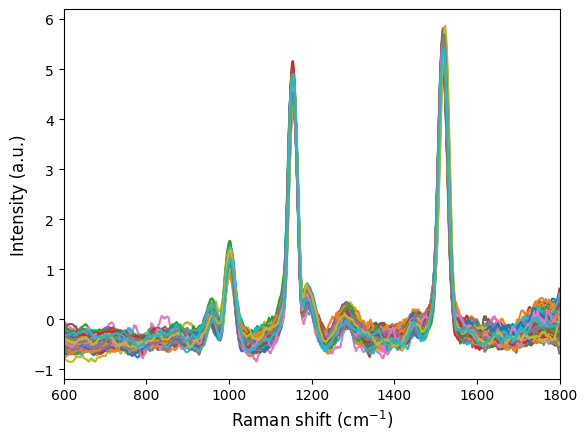

In [17]:
carpeta11= SNR(ruta11, 'no', 'no', 'si')

esto el que hay en  ['180324_UAM588_planosuperior_300ms_1acc_pwras_5um.CSV']
Procesando 180324_UAM588_planosuperior_300ms_1acc_pwras_5um.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


180324_UAM588_planosuperior_300ms_1acc_pwras_5um.CSV: se descartaron 2 espectros saturados de un total de 10836 espectros.
ALS did not converge in 40 iterations


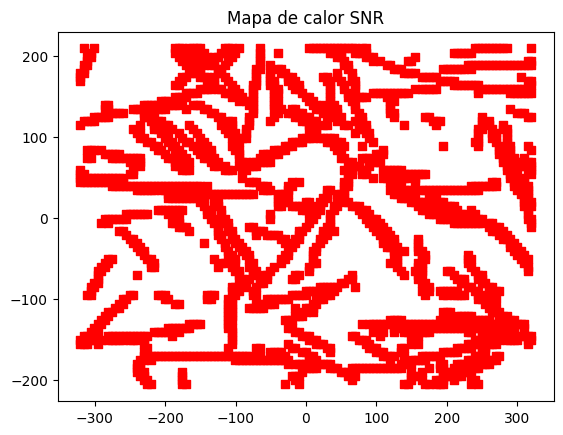

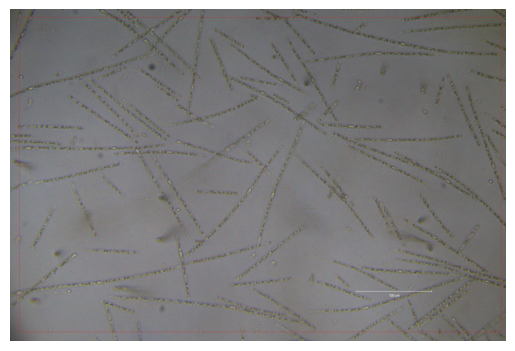

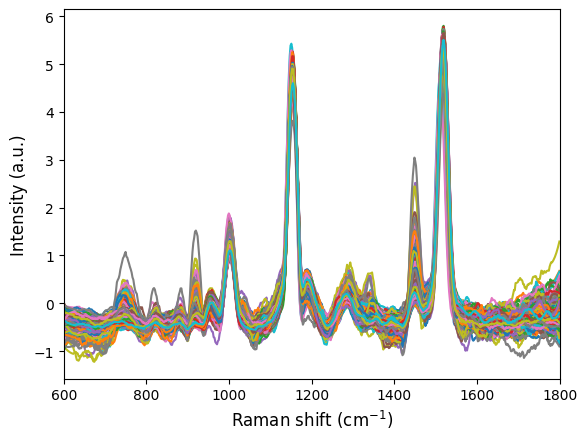

In [18]:
carpeta12= SNR(ruta12, 'no', 'no', 'si')

esto el que hay en  ['180324_UAM588_planosuperior_300ms_1acc_pwras_20um.CSV']
Procesando 180324_UAM588_planosuperior_300ms_1acc_pwras_20um.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


180324_UAM588_planosuperior_300ms_1acc_pwras_20um.CSV: se descartaron 2 espectros saturados de un total de 693 espectros.


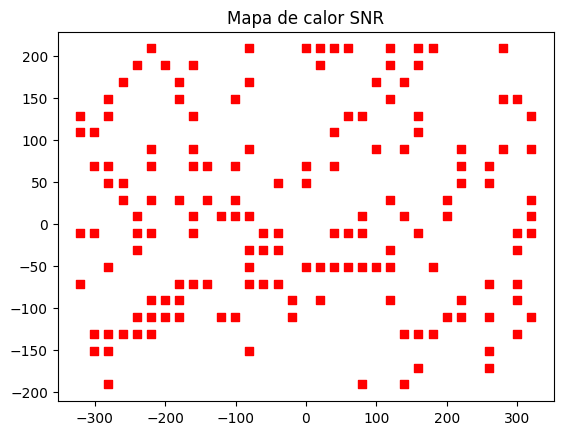

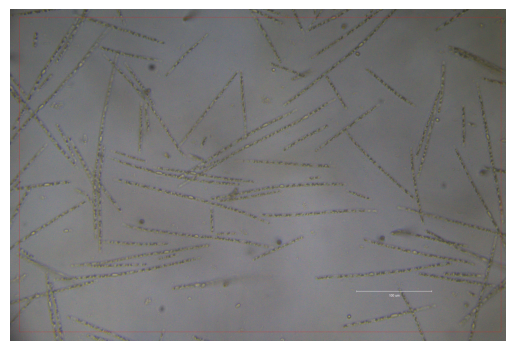

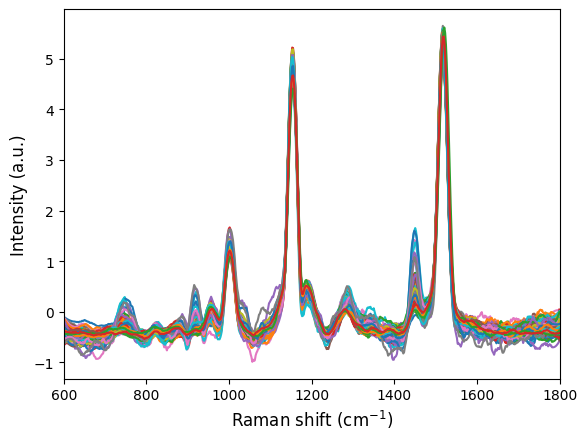

In [19]:
carpeta13= SNR(ruta13, 'no', 'no', 'si')

esto el que hay en  ['180324_UAM588_planosuperior_300ms_1acc_pwras_20um.CSV']
Procesando 180324_UAM588_planosuperior_300ms_1acc_pwras_20um.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


180324_UAM588_planosuperior_300ms_1acc_pwras_20um.CSV: se descartaron 2 espectros saturados de un total de 693 espectros.


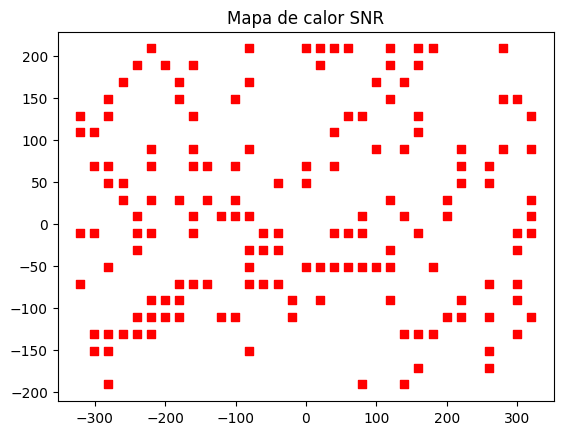

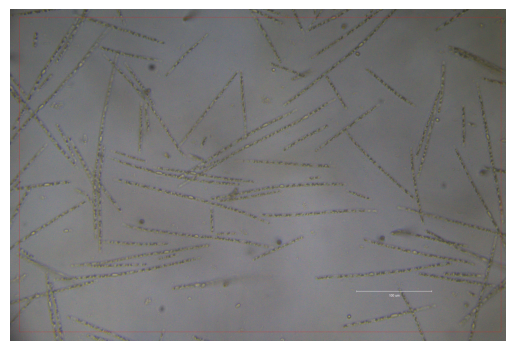

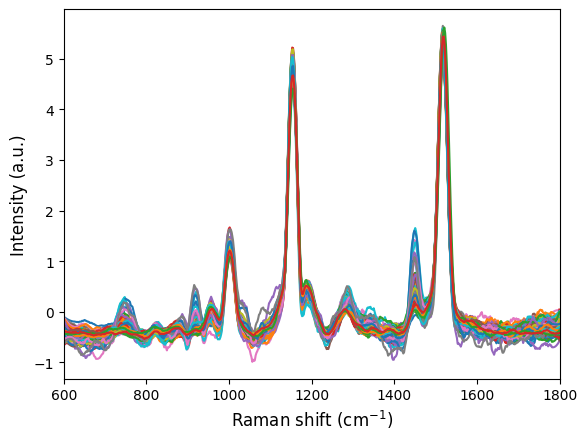

In [20]:
carpeta14= SNR(ruta14, 'no', 'no', 'si')

esto el que hay en  ['190324_UAM588_restos_planoabajo_300ms_1acc_pwras_6um.CSV']
Procesando 190324_UAM588_restos_planoabajo_300ms_1acc_pwras_6um.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


190324_UAM588_restos_planoabajo_300ms_1acc_pwras_6um.CSV: se descartaron 0 espectros saturados de un total de 4399 espectros.


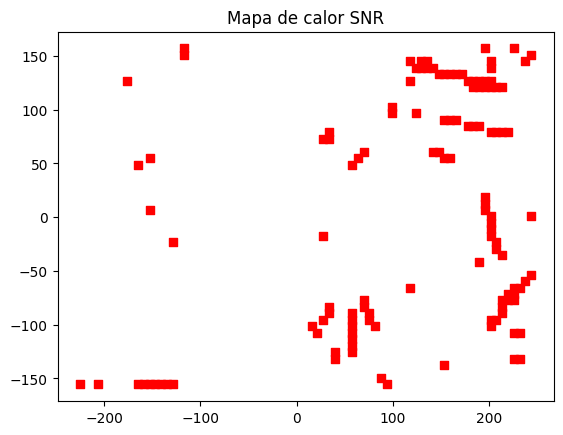

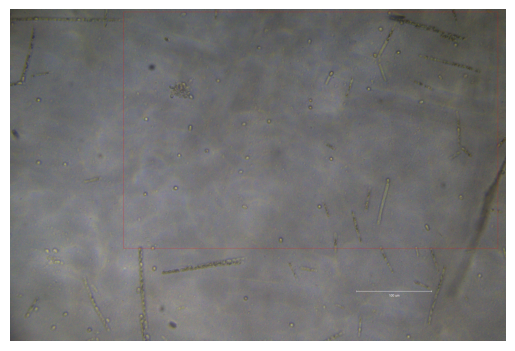

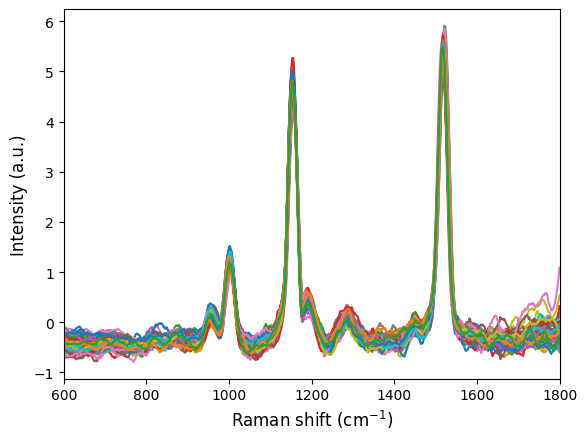

In [21]:
carpeta15= SNR(ruta15, 'no', 'no', 'si')

esto el que hay en  ['190324_UAM588_restos_planoarriba_300ms_1acc_pwras_6um.CSV']
Procesando 190324_UAM588_restos_planoarriba_300ms_1acc_pwras_6um.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


190324_UAM588_restos_planoarriba_300ms_1acc_pwras_6um.CSV: se descartaron 3 espectros saturados de un total de 1904 espectros.


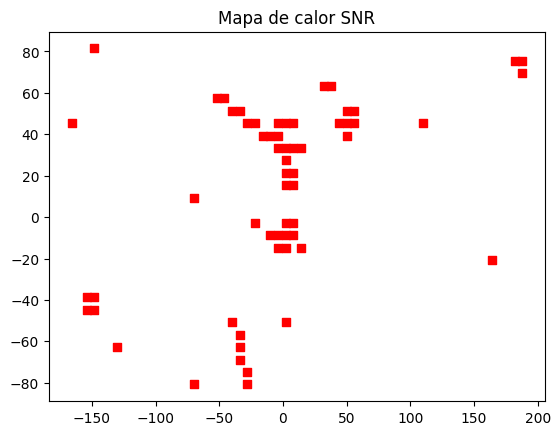

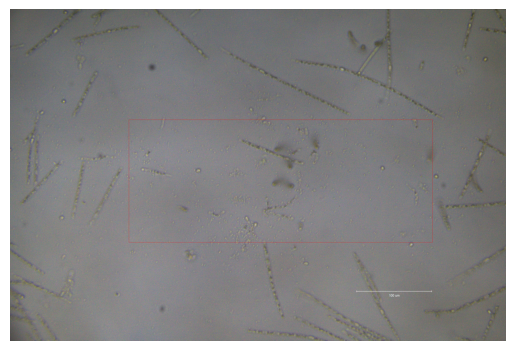

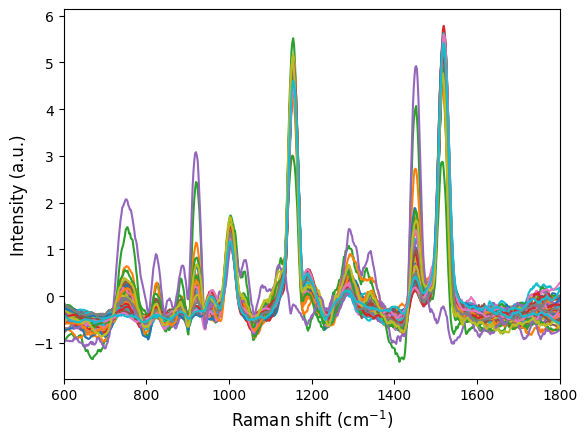

In [22]:
carpeta16= SNR(ruta16, 'no', 'no', 'si')

In [23]:
carpeta16[4].index


Int64Index([   9,  132,  133,  201,  243,  244,  297,  298,  367,  368,  382,
             383,  414,  437,  438,  441,  442,  443,  449,  450,  451,  460,
             507,  508,  509,  510,  518,  577,  578,  579,  580,  646,  714,
             715,  782,  783,  838,  982,  986,  987, 1052, 1053, 1054, 1055,
            1121, 1122, 1124, 1217, 1368, 1369, 1436, 1437, 1523, 1530, 1592,
            1644, 1660, 1728, 1797, 1858, 1865],
           dtype='int64')

Index(['X', 'Y', 'Z', 'XINDEX', 'YINDEX', 'ZINDEX', '-79.261', '-77.023',
       '-74.786', '-72.548',
       ...
       '3302.572', '3303.737', '3304.903', '3306.073', '3307.240', '3308.405',
       '3309.569', '3310.733', '3311.896', '3313.058'],
      dtype='object', length=1937)


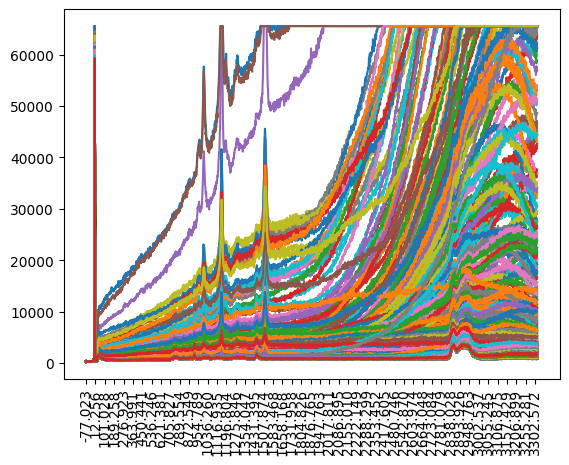

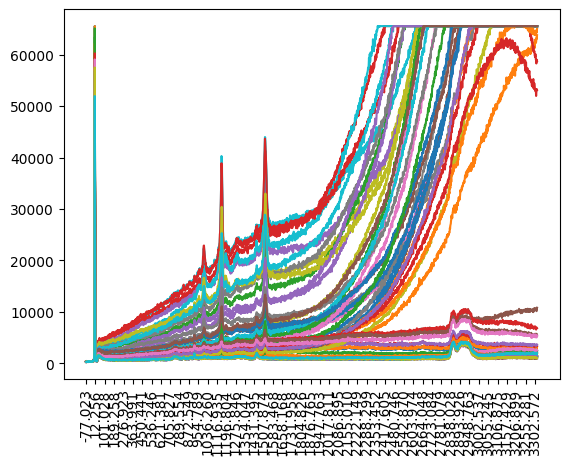

In [24]:
# Quiero obtener de los los ramashifts originales
data16= pd.read_csv(r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM588\190324_UAM588_restos_planoarriba_300ms_1acc_pwras_6um\190324_UAM588_restos_planoarriba_300ms_1acc_pwras_6um.csv", engine='python', sep=',', skiprows=14, decimal='.')
data16 = data16.drop(columns=['Unnamed: 1937'])

# Verifica los nombres de las columnas
print(data16.columns)

'''# Filtra las columnas que puedan ser convertidas a float
valid_columns = []
for col in data16.columns:
    try:
        float(col)
        valid_columns.append(col)
    except ValueError:
        pass

# Convierte las columnas válidas a float y selecciona el rango deseado
filtered_columns = [col for col in valid_columns if 600.0 <= float(col) <= 1800.0]
data16 = data16.loc[:, filtered_columns]
# Hacemos un plor de todos los espectros'''
for i in range(len(data16)):
    plt.plot(data16.iloc[i, 7:])
    plt.xticks(ticks=np.arange(0, len(data16.columns), 40), labels=data16.columns[7::40], rotation=90)

plt.show()

# Plot de los espectros que cuyos indices estan en carpeta16[7] 
index= carpeta16[6]

for i in index:
    plt.plot(data16.iloc[i, 7:])
    plt.xticks(ticks=np.arange(0, len(data16.columns), 40), labels=data16.columns[7::40], rotation=90)
plt.show()


In [25]:
# Cuantos eespectros buenos tengo en total
total = carpeta1[1] + carpeta2[1] + carpeta3[1] + carpeta4[1] + carpeta5[1] + carpeta6[1] + carpeta7[1] + carpeta8[1] + carpeta9[1] + carpeta10[1] + carpeta11[1] + carpeta12[1] + carpeta13[1] + carpeta14[1] + carpeta15[1]+carpeta16[1]
print('El total de espectros buenos es de ', total)
print(carpeta12[1])

El total de espectros buenos es de  4483
2110


Con filtrado de relacion SNR mayor que 14 tenia 4714 pero en 12 y 9 habia falsos positivos.

Con filtrado de relacion SNR mayor que 15 tengo 4423 sin falsos positivos. Aún asío hay datos raros.

In [26]:
ruta502_1= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM502\060624_UAM502_individuales_planoarriba_300ms_1acc_pwras_5um"
ruta502_2= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM502\310524_UAM502_individuales_1s_1acc_pwmuescaentre1y2_5um_14"
ruta502_3= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM502\310524_UAM502_individuales_1s_1acc_pwmuescaentre1y2_5um_15"
ruta502_4= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM502\310524_UAM502_individuales_1s_1acc_pwmuescaentre1y2_5um_16"
ruta502_5= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM502\310524_UAM502_individuales_300ms_1acc_pwras_5um_1"
ruta502_6= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM502\310524_UAM502_individuales_300ms_1acc_pwras_5um_2"
ruta502_7= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM502\310524_UAM502_individuales_300ms_1acc_pwras_5um_3"
ruta502_8= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM502\310524_UAM502_individuales_300ms_1acc_pwras_5um_4"
ruta502_9= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM502\310524_UAM502_individuales_300ms_1acc_pwras_5um_5"
ruta502_10= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM502\310524_UAM502_individuales_500ms_1acc_pwcasi1_5um_6"
ruta502_11= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM502\310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_7"
ruta502_12= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM502\310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_8"
ruta502_13= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM502\310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_9"
ruta502_14= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM502\310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_10"
ruta502_15= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM502\310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_11"
ruta502_16= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM502\310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_12"
ruta502_17= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM502\310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_13"   


esto el que hay en  ['060624_UAM502_individuales_planoarriba_300ms_1acc_pwras_5um.CSV']
Procesando 060624_UAM502_individuales_planoarriba_300ms_1acc_pwras_5um.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


060624_UAM502_individuales_planoarriba_300ms_1acc_pwras_5um.CSV: se descartaron 285 espectros saturados de un total de 9088 espectros.


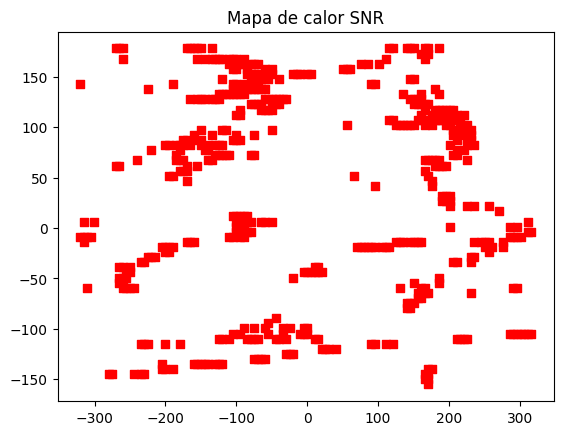

No image file containing 'PRE' found in the specified directory.


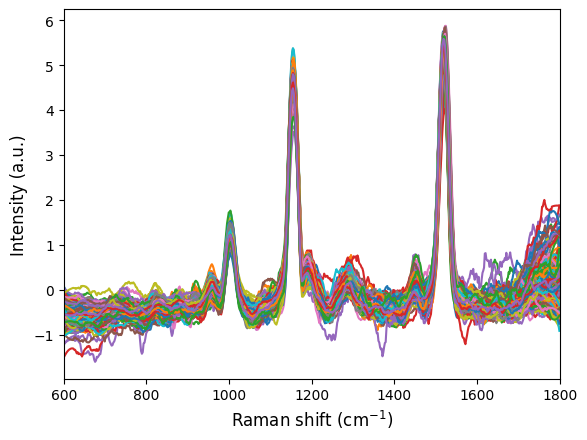

In [27]:
carpeta502_1= SNR(ruta502_1, 'no', 'no', 'si')

esto el que hay en  ['310524_UAM502_individuales_1s_1acc_pwmuescaentre1y2_5um_14.CSV']
Procesando 310524_UAM502_individuales_1s_1acc_pwmuescaentre1y2_5um_14.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


310524_UAM502_individuales_1s_1acc_pwmuescaentre1y2_5um_14.CSV: se descartaron 84 espectros saturados de un total de 7680 espectros.


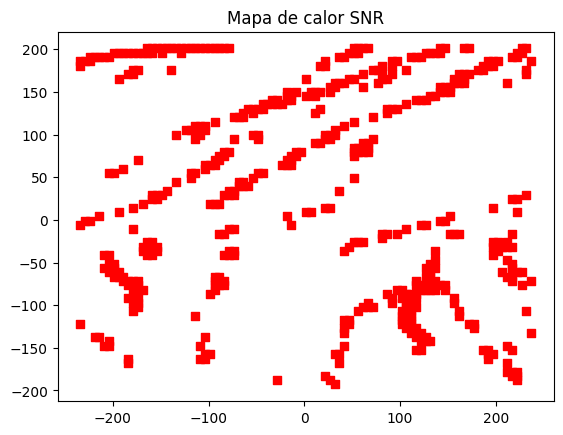

No image file containing 'PRE' found in the specified directory.


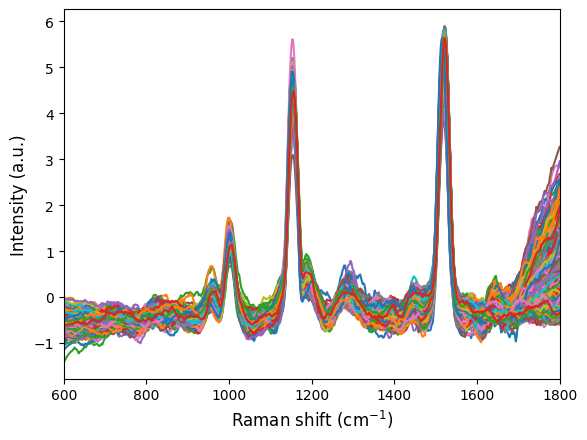

In [28]:
carpeta502_2= SNR(ruta502_2, 'no', 'no', 'si')

esto el que hay en  ['310524_UAM502_individuales_1s_1acc_pwmuescaentre1y2_5um_15.CSV']
Procesando 310524_UAM502_individuales_1s_1acc_pwmuescaentre1y2_5um_15.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


310524_UAM502_individuales_1s_1acc_pwmuescaentre1y2_5um_15.CSV: se descartaron 56 espectros saturados de un total de 1308 espectros.


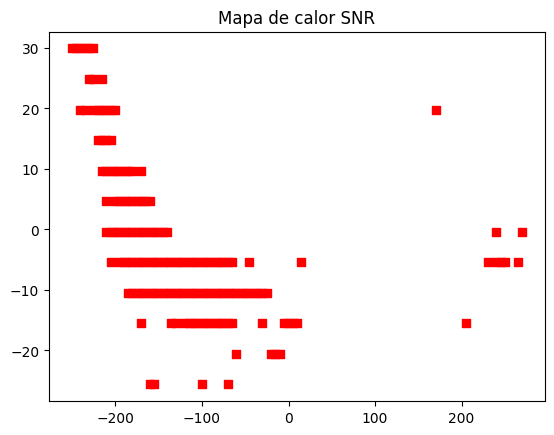

No image file containing 'PRE' found in the specified directory.


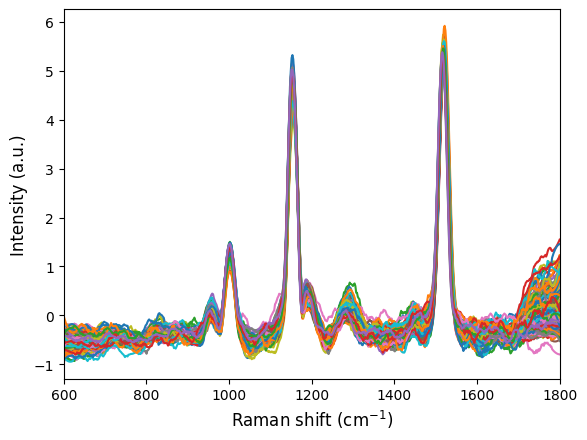

In [29]:
carpeta502_3= SNR(ruta502_3, 'no', 'no', 'si')

esto el que hay en  ['310524_UAM502_individuales_1s_1acc_pwmuescaentre1y2_5um_16.CSV']
Procesando 310524_UAM502_individuales_1s_1acc_pwmuescaentre1y2_5um_16.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


310524_UAM502_individuales_1s_1acc_pwmuescaentre1y2_5um_16.CSV: se descartaron 7 espectros saturados de un total de 4060 espectros.


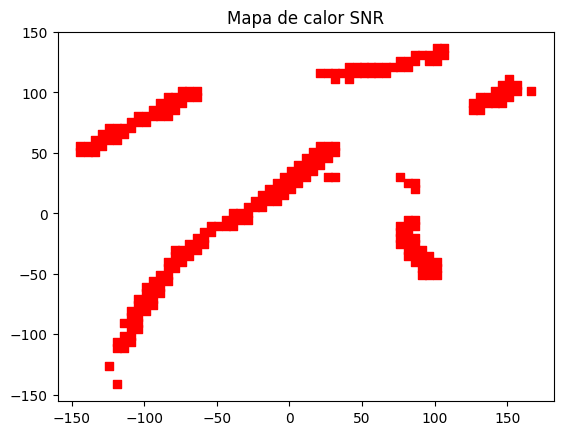

No image file containing 'PRE' found in the specified directory.


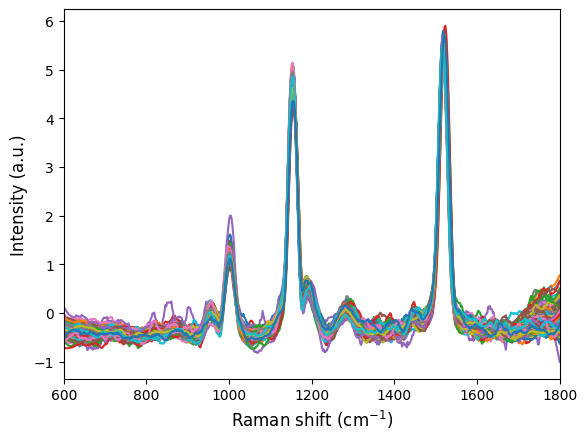

In [30]:
carpeta502_4= SNR(ruta502_4, 'no', 'no', 'si')

esto el que hay en  ['310524_UAM502_individuales_300ms_1acc_pwras_5um_1.CSV']
Procesando 310524_UAM502_individuales_300ms_1acc_pwras_5um_1.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


310524_UAM502_individuales_300ms_1acc_pwras_5um_1.CSV: se descartaron 25 espectros saturados de un total de 1045 espectros.


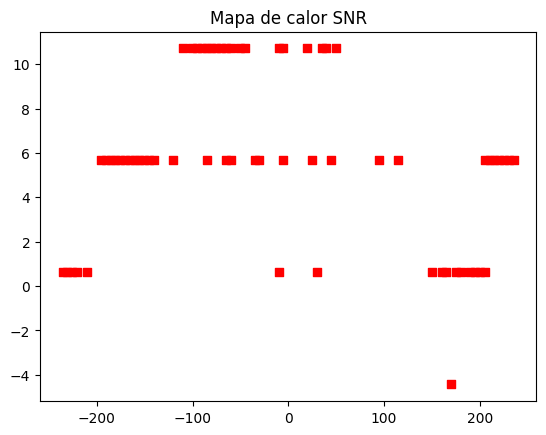

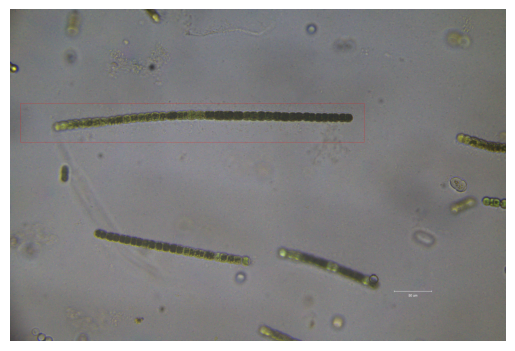

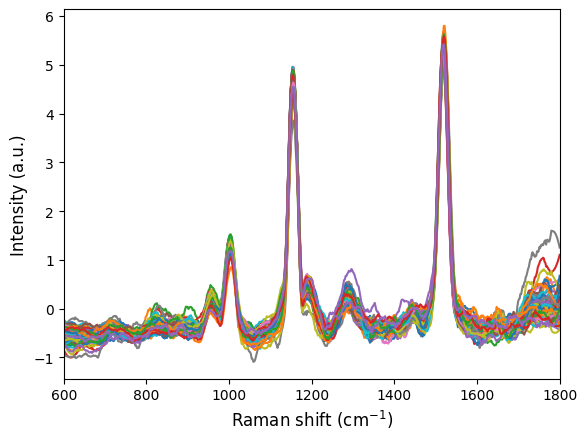

In [31]:
carpeta502_5= SNR(ruta502_5, 'no', 'no', 'si')

esto el que hay en  ['310524_UAM502_individuales_300ms_1acc_pwras_5um_2.CSV']
Procesando 310524_UAM502_individuales_300ms_1acc_pwras_5um_2.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


310524_UAM502_individuales_300ms_1acc_pwras_5um_2.CSV: se descartaron 4 espectros saturados de un total de 480 espectros.


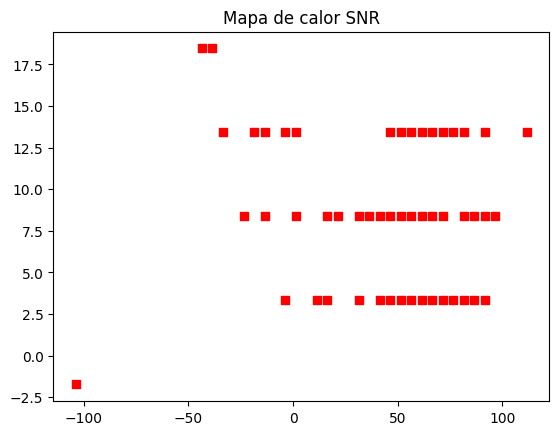

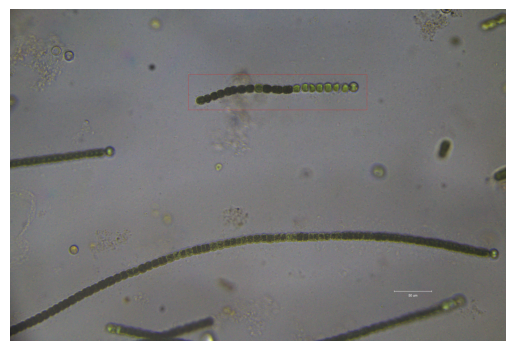

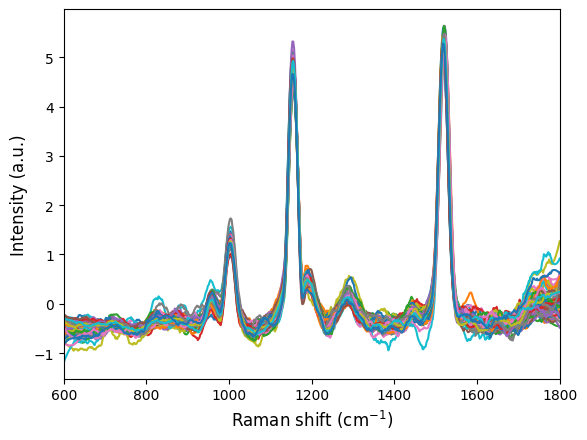

In [32]:
carpeta502_6= SNR(ruta502_6, 'no', 'no', 'si')

esto el que hay en  ['310524_UAM502_individuales_300ms_1acc_pwras_5um_3.CSV']
Procesando 310524_UAM502_individuales_300ms_1acc_pwras_5um_3.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


310524_UAM502_individuales_300ms_1acc_pwras_5um_3.CSV: se descartaron 0 espectros saturados de un total de 1258 espectros.


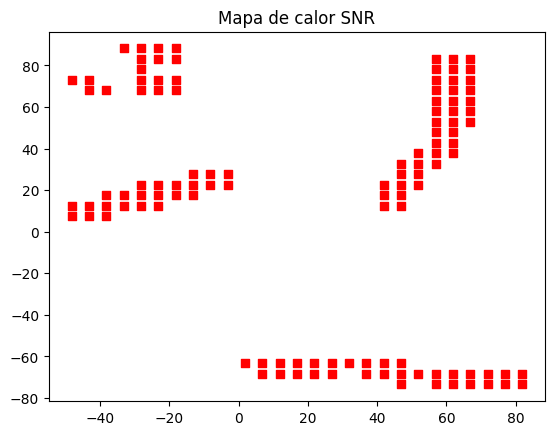

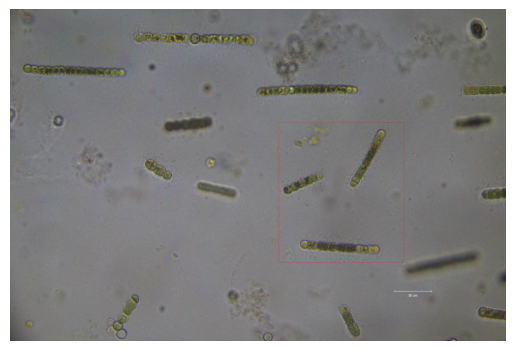

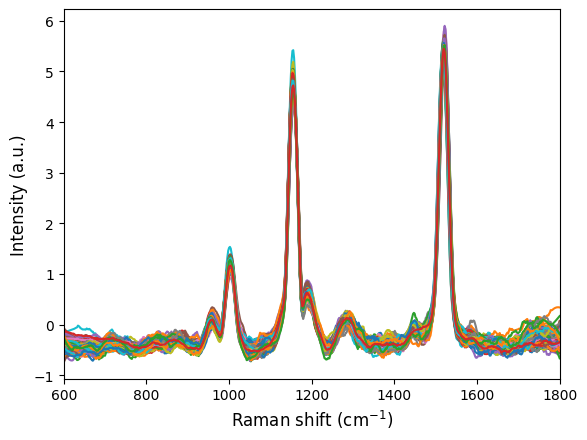

In [33]:
carpeta502_7= SNR(ruta502_7, 'no', 'no', 'si')  

esto el que hay en  ['310524_UAM502_individuales_300ms_1acc_pwras_5um_4.CSV']
Procesando 310524_UAM502_individuales_300ms_1acc_pwras_5um_4.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


310524_UAM502_individuales_300ms_1acc_pwras_5um_4.CSV: se descartaron 52 espectros saturados de un total de 7656 espectros.


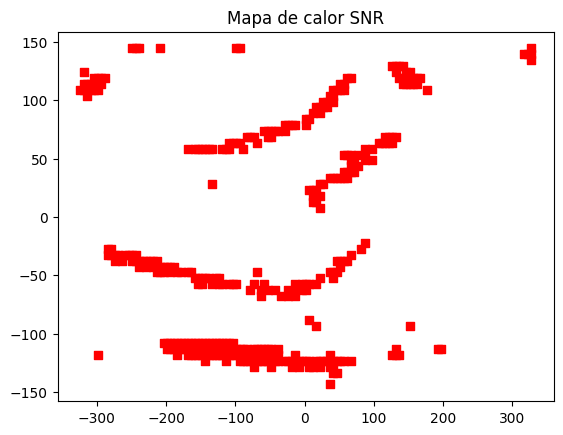

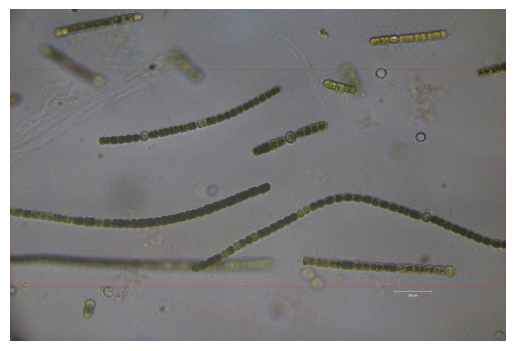

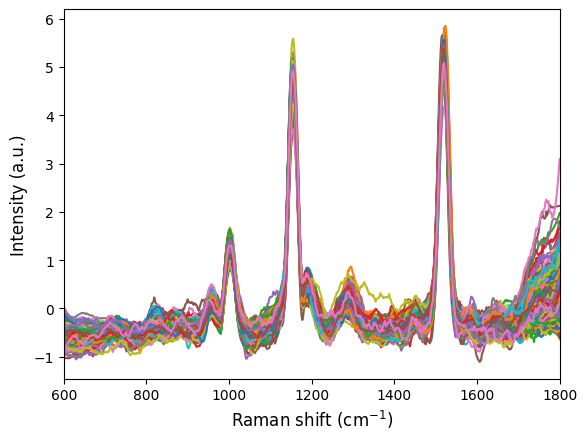

In [34]:
carpeta502_8= SNR(ruta502_8, 'no', 'no', 'si')

esto el que hay en  ['310524_UAM502_individuales_300ms_1acc_pwras_5um_5.CSV']
Procesando 310524_UAM502_individuales_300ms_1acc_pwras_5um_5.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


310524_UAM502_individuales_300ms_1acc_pwras_5um_5.CSV: se descartaron 0 espectros saturados de un total de 3422 espectros.


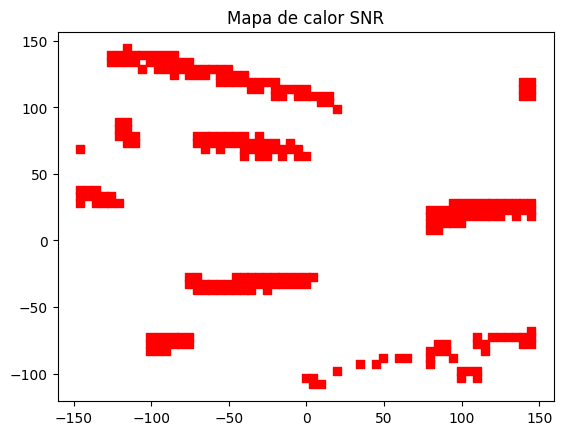

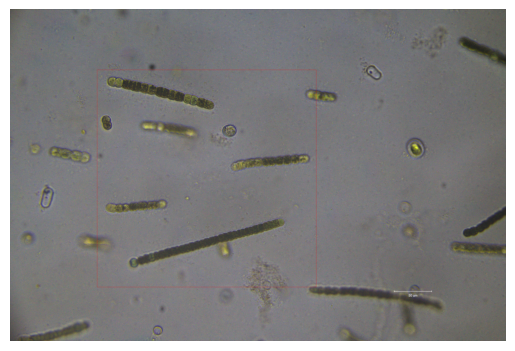

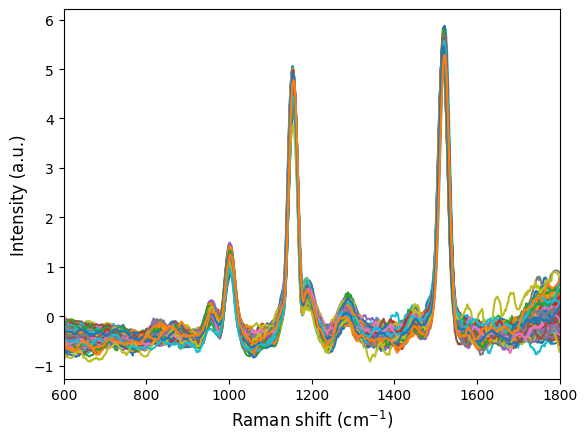

In [35]:
carpeta502_9= SNR(ruta502_9, 'no', 'no', 'si')

esto el que hay en  ['310524_UAM502_individuales_500ms_1acc_pwcasi1_5um_6.CSV']
Procesando 310524_UAM502_individuales_500ms_1acc_pwcasi1_5um_6.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


310524_UAM502_individuales_500ms_1acc_pwcasi1_5um_6.CSV: se descartaron 3 espectros saturados de un total de 2440 espectros.


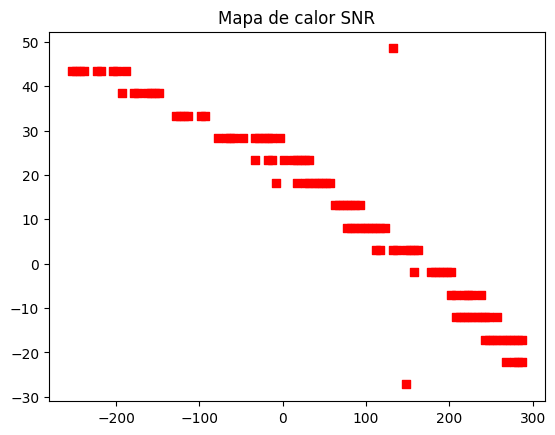

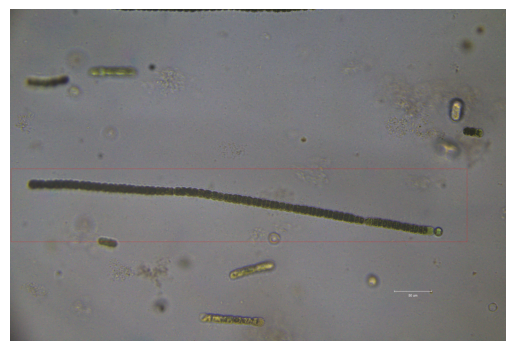

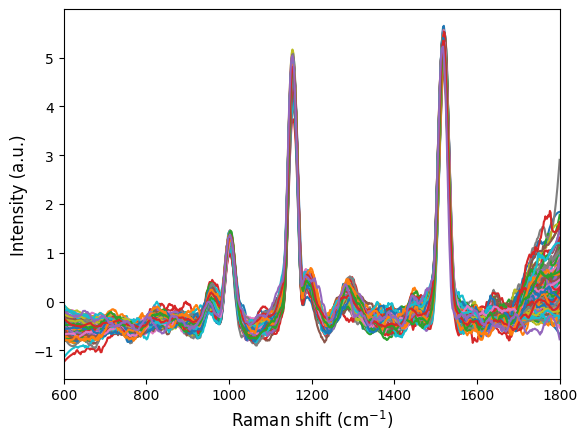

In [36]:
carpeta502_10= SNR(ruta502_10, 'no', 'no', 'si')

esto el que hay en  ['310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_7.CSV']
Procesando 310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_7.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_7.CSV: se descartaron 137 espectros saturados de un total de 8710 espectros.


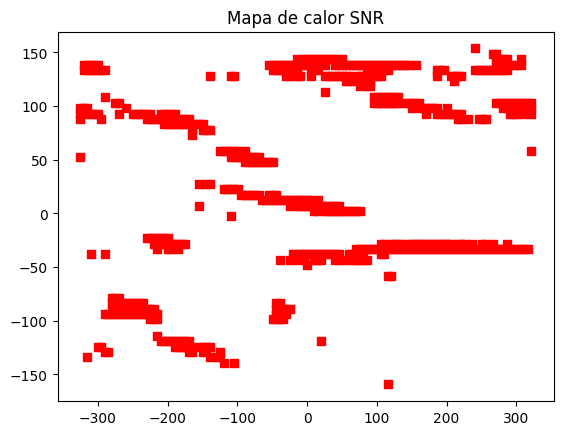

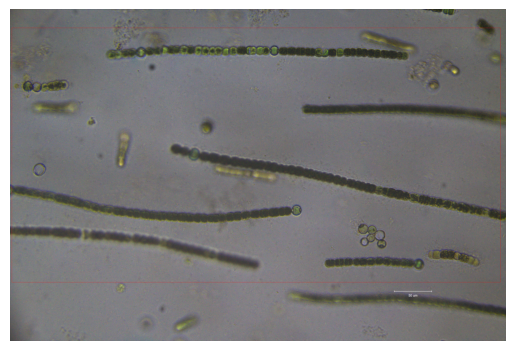

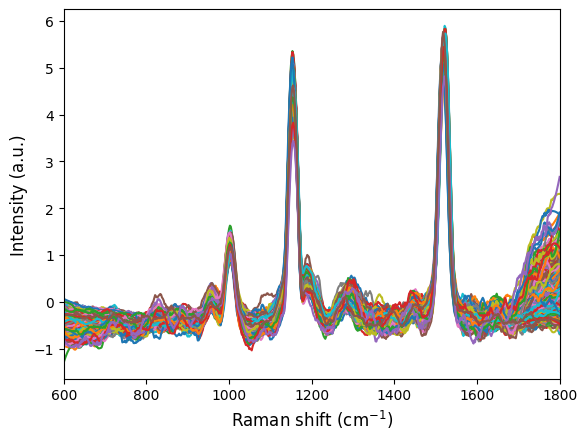

In [37]:
carpeta502_11= SNR(ruta502_11, 'no', 'no', 'si')

esto el que hay en  ['310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_8.CSV']
Procesando 310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_8.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_8.CSV: se descartaron 92 espectros saturados de un total de 7742 espectros.


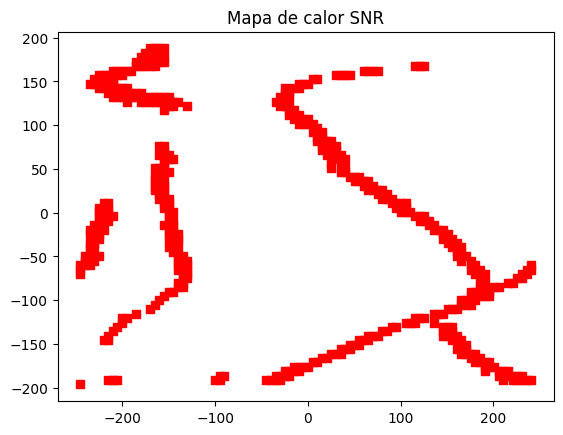

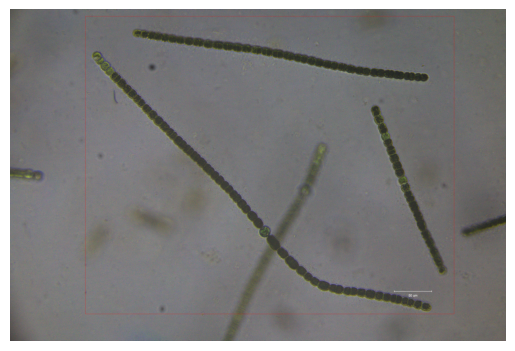

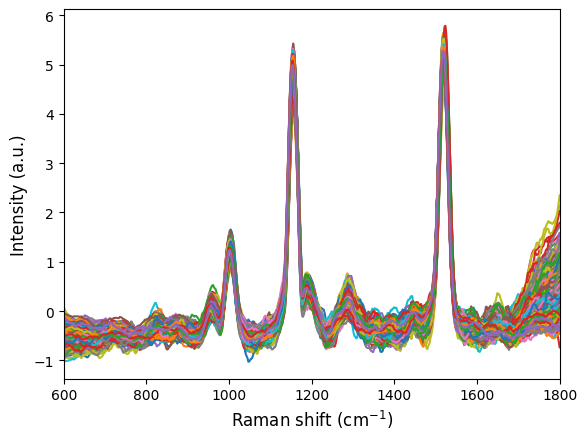

In [38]:
carpeta502_12= SNR(ruta502_12, 'no', 'no', 'si')

esto el que hay en  ['310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_9.CSV']
Procesando 310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_9.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_9.CSV: se descartaron 41 espectros saturados de un total de 5640 espectros.
ALS did not converge in 40 iterations


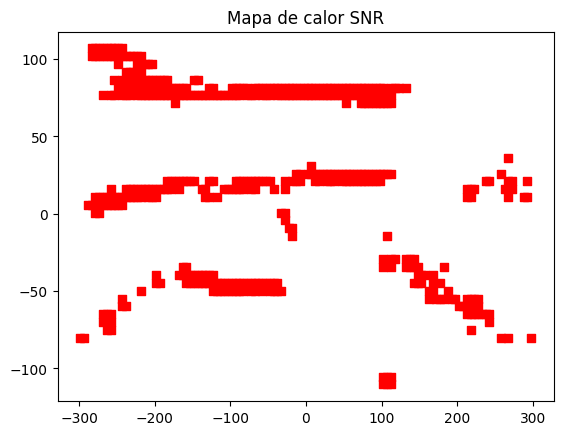

No image file containing 'PRE' found in the specified directory.


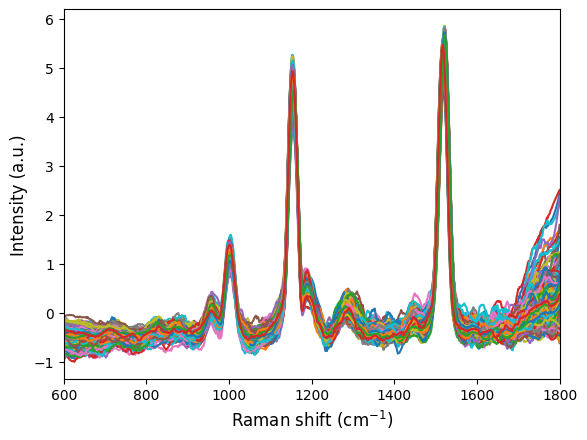

In [39]:
carpeta502_13= SNR(ruta502_13, 'no', 'no', 'si')

esto el que hay en  ['310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_10.CSV']
Procesando 310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_10.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_10.CSV: se descartaron 7 espectros saturados de un total de 6138 espectros.


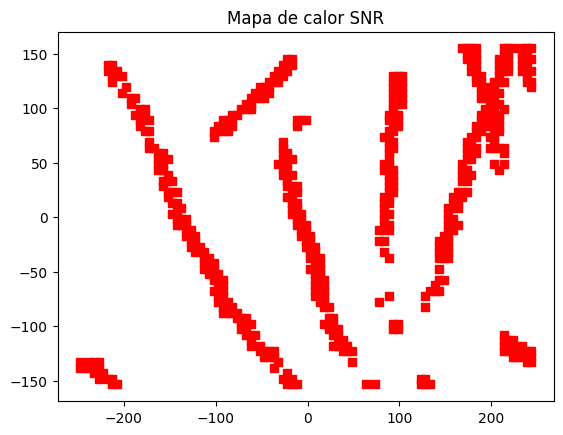

No image file containing 'PRE' found in the specified directory.


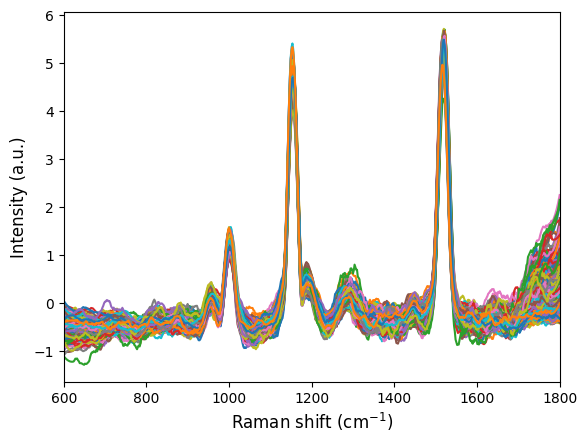

In [40]:
carpeta502_14= SNR(ruta502_14, 'no', 'no', 'si')

esto el que hay en  ['310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_11.CSV']
Procesando 310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_11.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_11.CSV: se descartaron 58 espectros saturados de un total de 9150 espectros.
ALS did not converge in 40 iterations


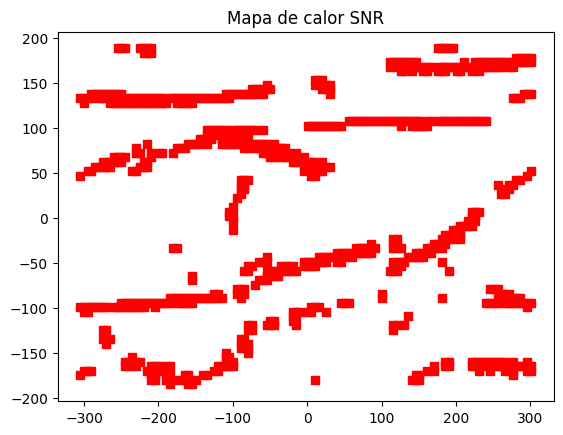

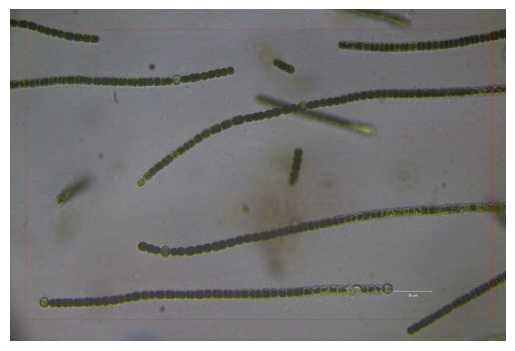

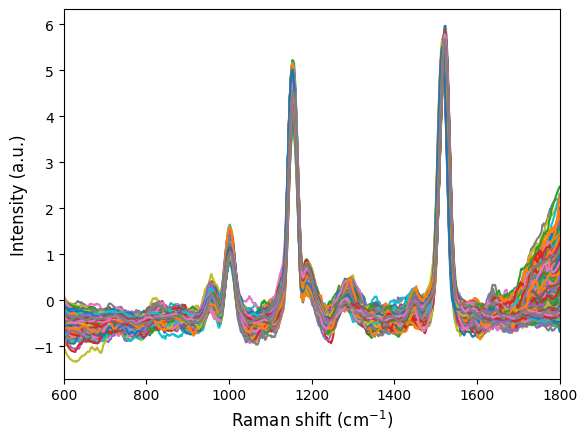

In [41]:
carpeta502_15= SNR(ruta502_15, 'no', 'no', 'si')

esto el que hay en  ['310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_12.CSV']
Procesando 310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_12.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_12.CSV: se descartaron 187 espectros saturados de un total de 6110 espectros.


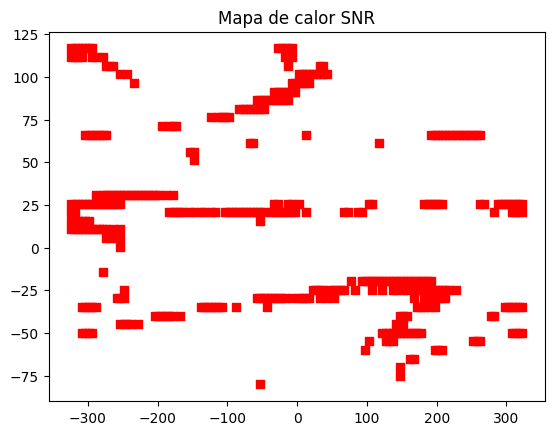

No image file containing 'PRE' found in the specified directory.


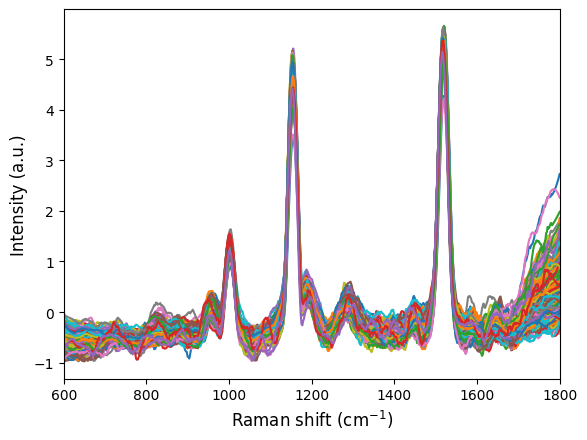

In [42]:
carpeta502_16= SNR(ruta502_16, 'no', 'no', 'si')

esto el que hay en  ['310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_13.CSV']
Procesando 310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_13.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


310524_UAM502_individuales_500ms_1acc_pwmuescacasi1_5um_13.CSV: se descartaron 42 espectros saturados de un total de 7410 espectros.
ALS did not converge in 40 iterations


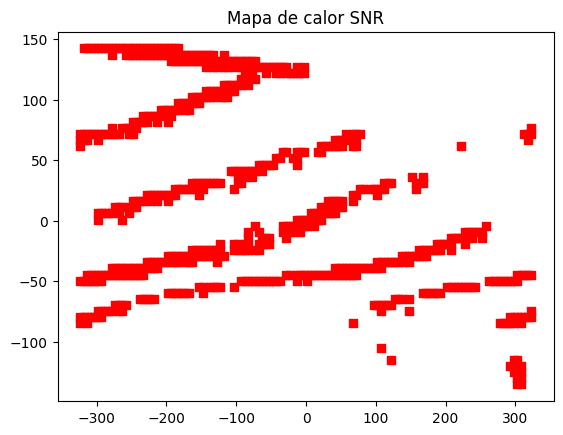

No image file containing 'PRE' found in the specified directory.


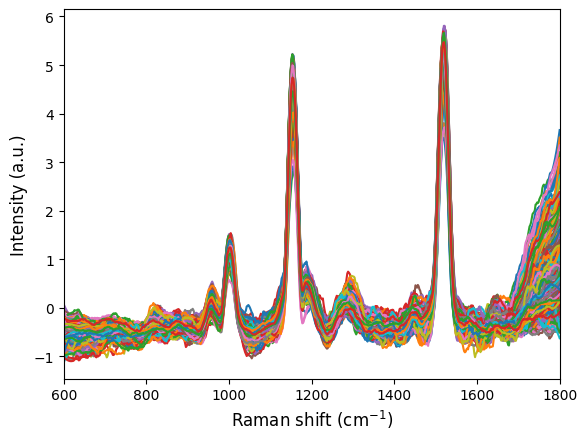

In [43]:
carpeta502_17= SNR(ruta502_17, 'no', 'no', 'si')

In [44]:
total502= carpeta502_1[1]+carpeta502_2[1]+carpeta502_3[1]+carpeta502_4[1]+carpeta502_5[1]+carpeta502_6[1]+carpeta502_7[1]+carpeta502_8[1]+carpeta502_9[1]+carpeta502_10[1]+carpeta502_11[1]+carpeta502_12[1]+carpeta502_13[1]+carpeta502_14[1]+carpeta502_15[1]+carpeta502_16[1]+carpeta502_17[1]
print('El total de espectros buenos es de ', total502)


El total de espectros buenos es de  6323


esto el que hay en  ['medidaplastico_400ms_pwras.CSV']
Procesando medidaplastico_400ms_pwras.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


medidaplastico_400ms_pwras.CSV: se descartaron 0 espectros saturados de un total de 120 espectros.


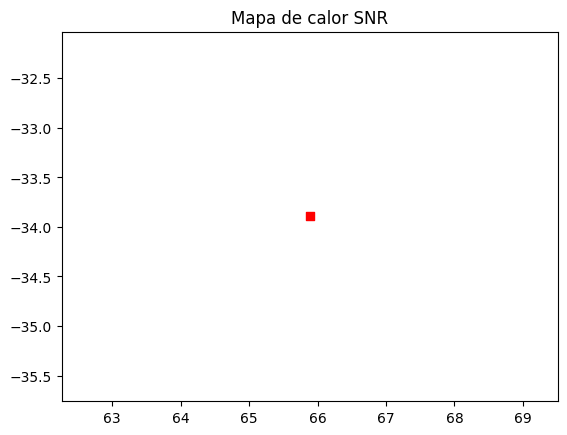

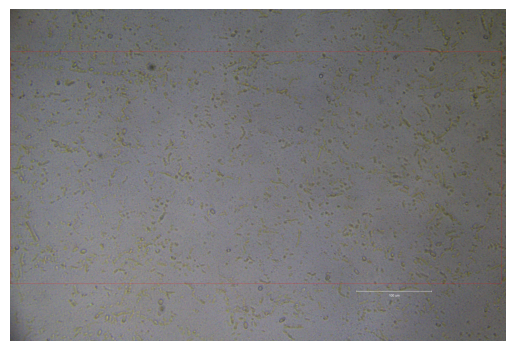

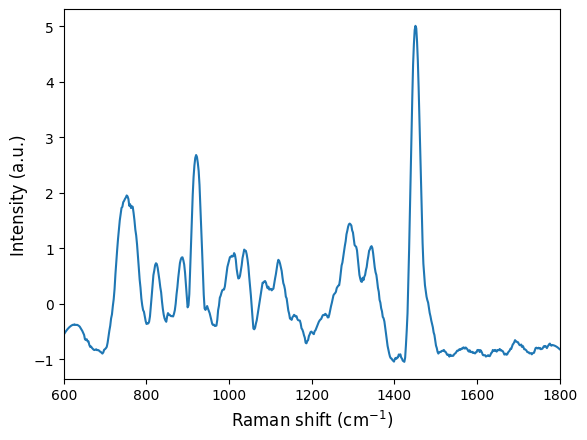

In [45]:
# Cargamos el csv del plastico
ruta_plastico = r'C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge'
carpeta_plastico = SNR(ruta_plastico, 'no', 'no', 'si')



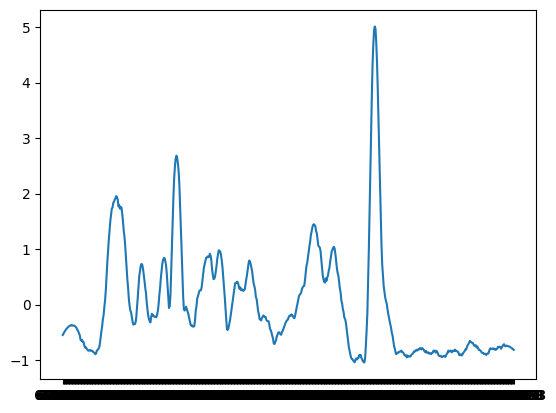

600.416    -0.547383
602.534    -0.521519
604.659    -0.497598
606.781    -0.475620
608.904    -0.455586
              ...   
1792.439   -0.771439
1794.253   -0.780754
1796.068   -0.791200
1797.883   -0.802778
1799.693   -0.815487
Name: 0, Length: 608, dtype: float64


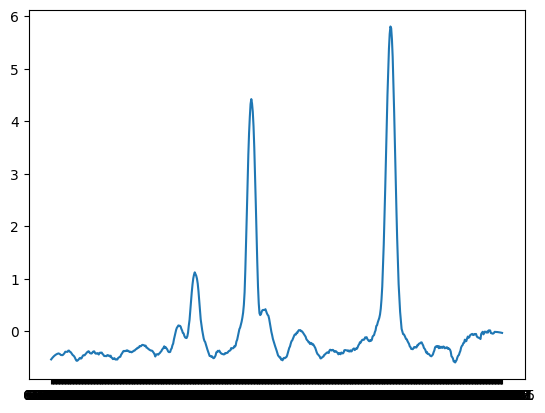

601.943    -0.537953
604.064    -0.519275
606.187    -0.502196
608.312    -0.486718
610.433    -0.472839
              ...   
1791.881   -0.020454
1793.697   -0.022957
1795.511   -0.025798
1797.321   -0.028974
1799.135   -0.032488
Name: 12, Length: 607, dtype: float64


In [46]:
# Guardamos los datos de un espectro normalizado de plastico
plastico = carpeta_plastico[0].iloc[0, :]

plt.plot(plastico)
plt.show()

print (plastico)
snr1= carpeta1[0]
# Cogemos la fila con que tenga el valor mas grande de snr1
maximo = snr1.max(axis=1)
# Cogemos el indice de la fila con el valor mas grande
indice_maximo = maximo.idxmax()
# Cogemos el espectro con el valor mas grande
UAM588= snr1.iloc[indice_maximo, :]
plt.plot(UAM588)
plt.show()
print(UAM588)

      Spectrum_1  Spectrum_2  Spectrum_3  Spectrum_4  Spectrum_5  Spectrum_6  \
600    -0.387397   -0.356808   -0.276028   -0.313070   -0.186593   -0.200434   
601    -0.387397   -0.356808   -0.276028   -0.313070   -0.186593   -0.200434   
602    -0.388703   -0.356801   -0.276437   -0.313027   -0.186743   -0.200650   
603    -0.411616   -0.356669   -0.283611   -0.312269   -0.189376   -0.204454   
604    -0.434530   -0.356538   -0.290784   -0.311511   -0.192009   -0.208257   
...          ...         ...         ...         ...         ...         ...   
1796   -0.295494   -0.282090   -0.241790   -0.278013   -0.401010   -0.350413   
1797   -0.282443   -0.274384   -0.236738   -0.272699   -0.407355   -0.349144   
1798   -0.268111   -0.266098   -0.231126   -0.266870   -0.413918   -0.347598   
1799   -0.253174   -0.257537   -0.225249   -0.260797   -0.420584   -0.345920   
1800   -0.251158   -0.256382   -0.224456   -0.259977   -0.421484   -0.345693   

      Spectrum_7  Spectrum_8  Spectrum_

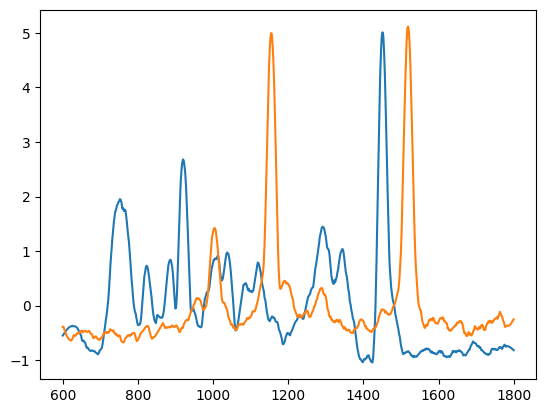

In [47]:
# Create a new wavenumber range from 180 to 1790 cm-1 with a step of 1 cm-1

new_wavenumbers = np.arange(600, 1801, 1)

# Create an empty DataFrame to store the interpolated values

interpolated_df = pd.DataFrame(index=new_wavenumbers)

# Interpolate the values for each spectrum

for i in range(carpeta1[0].shape[0]):

    original_wavenumbers = carpeta1[0].columns.astype(float)

    spectrum_values = carpeta1[0].iloc[i].values.flatten().astype(float)

    interpolated_values = np.interp(new_wavenumbers, original_wavenumbers, spectrum_values)

    interpolated_df[f'Spectrum_{i+1}'] = interpolated_values

# Display the interpolated DataFrame

print(interpolated_df)

# hacemos una funcion que nos devuelva el espectro interpolado

def interpolado(data):

    # Create a new wavenumber range from 180 to 1790 cm-1 with a step of 1 cm-1

    new_wavenumbers = np.arange(600, 1801, 1)

    # Create an empty DataFrame to store the interpolated values

    interpolated_df = pd.DataFrame(index=new_wavenumbers)

    # Interpolate the values for each spectrum

    for i in range(data.shape[0]):

        original_wavenumbers = data.columns.astype(float)

        spectrum_values = data.iloc[i].values.flatten().astype(float)

        interpolated_values = np.interp(new_wavenumbers, original_wavenumbers, spectrum_values)

        interpolated_df[f'Spectrum_{i+1}'] = interpolated_values

    return interpolated_df

# interpolamos los datos de plastico
interpolado_plastico = interpolado(carpeta_plastico[0])

# interpolamos los datos de UAM588
interpolado_carpeta1 = interpolado(carpeta1[0])

# guardamos dos variables con la muestras de los espectros
plastico = interpolado_plastico.iloc[:, 0]
UAM588 = interpolado_carpeta1.iloc[:, 0]

plt.plot(plastico, label='Plastico')
plt.plot(UAM588, label='UAM588')




Percentage of material A: 85.63%
Percentage of material B: 14.37%


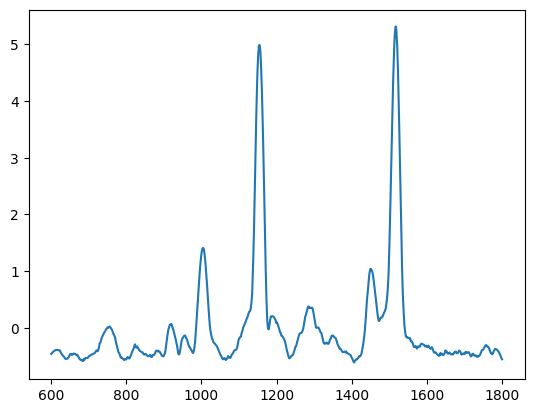

In [48]:
from sklearn.decomposition import FastICA
from scipy.optimize import nnls

# Juntamos UAM588 y plastico en una misma variable
puros = pd.concat([UAM588, plastico], axis=1)
puros.columns = ['UAM588', 'Plastico']
puros = puros.T

espectro_prueba = carpeta16[0]
espectro_prueba = interpolado(espectro_prueba)

espectro_prueba= espectro_prueba.iloc[:, 0]
espectro_prueba
plt.plot(espectro_prueba)  
# Perform NNLS unmixing
coefficients, _ = nnls(puros.T, espectro_prueba)

# Calculate the percentage of each material
total = coefficients.sum()
percentage_A = (coefficients[0] / total) * 100
percentage_B = (coefficients[1] / total) * 100

print(f"Percentage of material A: {percentage_A:.2f}%")
print(f"Percentage of material B: {percentage_B:.2f}%")


In [49]:
# Hacemos una funcion que nos devuelva los porcentajes de los materiales

def porcentajes(puros, espectro_prueba):
    # Perform NNLS unmixing
    coefficients, _ = nnls(puros.T, espectro_prueba)

    # Calculate the percentage of each material
    total = coefficients.sum()
    percentage_A = (coefficients[0] / total) * 100
    percentage_B = (coefficients[1] / total) * 100

    return percentage_A, percentage_B

In [50]:
# Hacemos una función que dandole una serie de espectro nos devuelva los porcentajes de los materiales de cada espectro

def porcentajes_materiales(puros, espectros):
    espectros = interpolado(espectros)
    # Create an empty DataFrame to store the results
    results = pd.DataFrame(index=espectros.columns, columns=['espectroA', 'espectroB'])

    # Calculate the percentage of each material for each spectrum
    for column in espectros.columns:
        percentage_A, percentage_B = porcentajes(puros, espectros[column])
        results.loc[column, 'espectroA'] = percentage_A
        results.loc[column, 'espectroB'] = percentage_B

    return results


# Calculamos los porcentajes de los materiales para los espectros de la carpeta16[0]
porcentaje_carpeta16= porcentajes_materiales(puros, carpeta16[0])




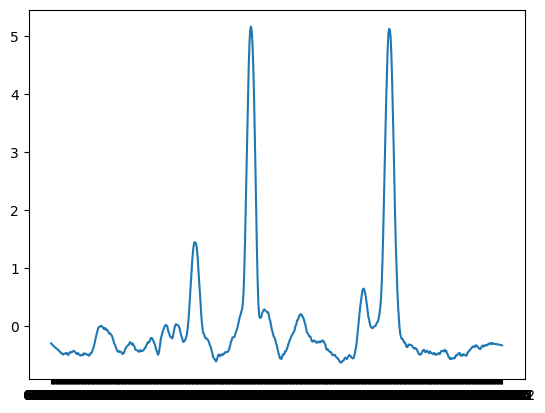

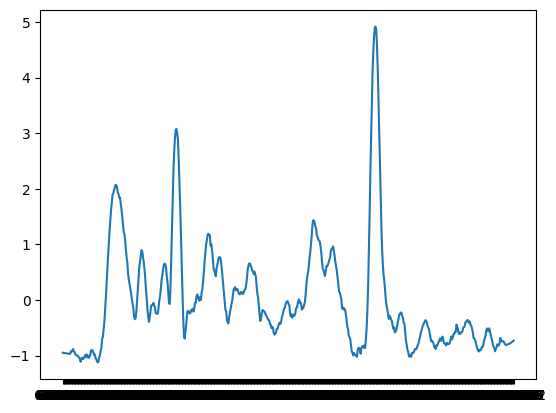

In [51]:
plt.plot(carpeta16[0].iloc[48,:])
plt.show()
plt.plot(carpeta16[0].iloc[54,:])   
plt.show()

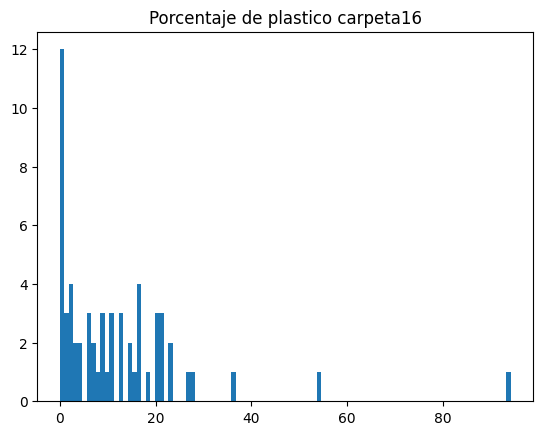

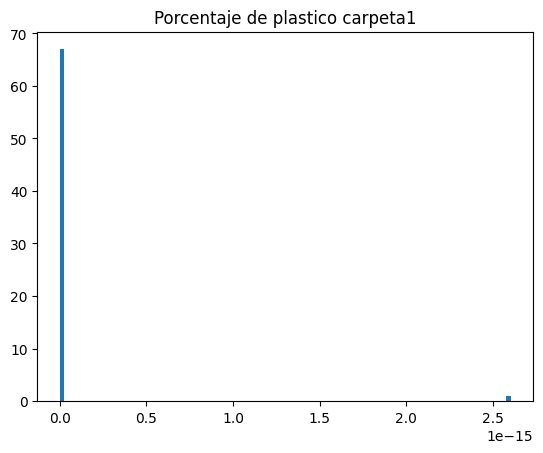

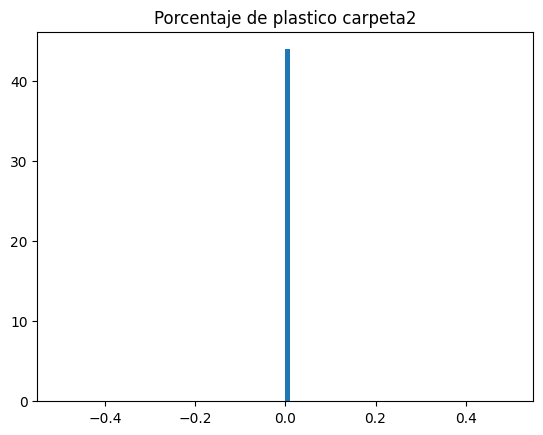

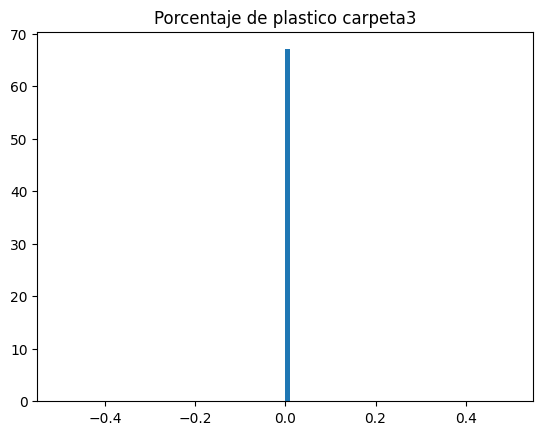

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

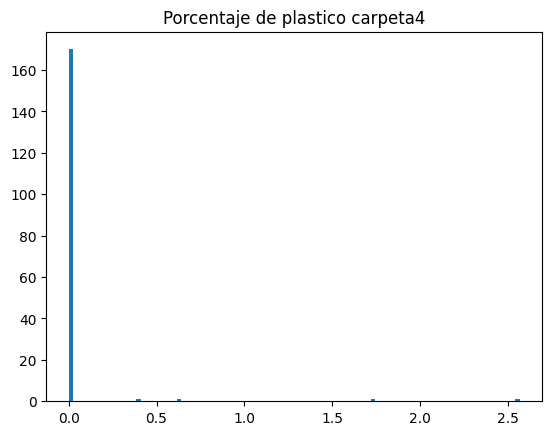

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

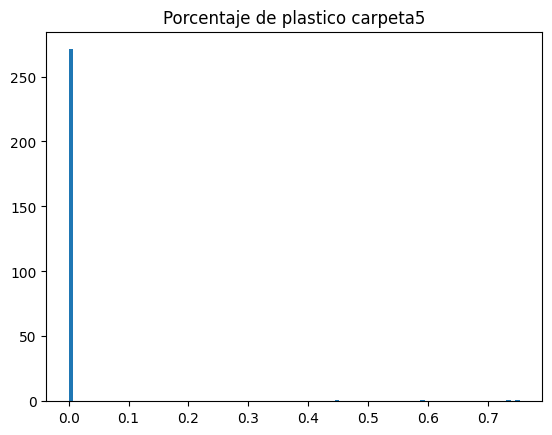

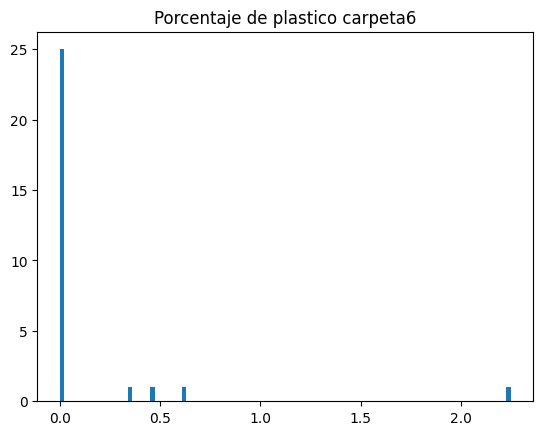

In [52]:
#hacemos un histograma de los porcentajes del plastico
plt.hist(porcentaje_carpeta16['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta16')
plt.show()

# Hacemos lo mismo para la carpeta1
porcentaje_carpeta1 = porcentajes_materiales(puros, carpeta1[0])
plt.hist(porcentaje_carpeta1['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta1')
plt.show()

# Hacemos lo mismo para la carpeta2
porcentaje_carpeta2 = porcentajes_materiales(puros, carpeta2[0])
plt.hist(porcentaje_carpeta2['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta2')
plt.show()

# Hacemos lo mismo para la carpeta3
porcentaje_carpeta3 = porcentajes_materiales(puros, carpeta3[0])
plt.hist(porcentaje_carpeta3['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta3')
plt.show()

# Hacemos lo mismo para la carpeta4
porcentaje_carpeta4 = porcentajes_materiales(puros, carpeta4[0])
plt.hist(porcentaje_carpeta4['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta4')
plt.show()

# Hacemos lo mismo para la carpeta5
porcentaje_carpeta5 = porcentajes_materiales(puros, carpeta5[0])
plt.hist(porcentaje_carpeta5['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta5')
plt.show()

# Hacemos lo mismo para la carpeta6
porcentaje_carpeta6 = porcentajes_materiales(puros, carpeta6[0])
plt.hist(porcentaje_carpeta6['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta6')
plt.show()


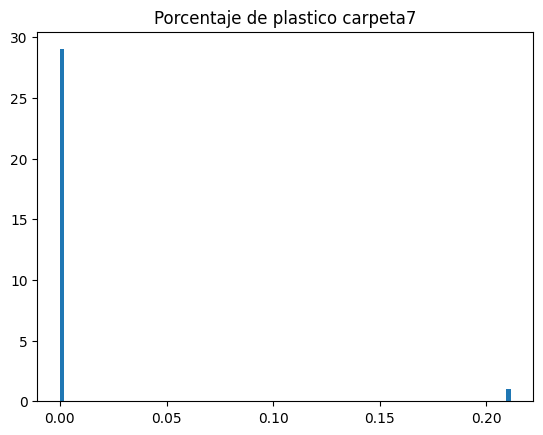

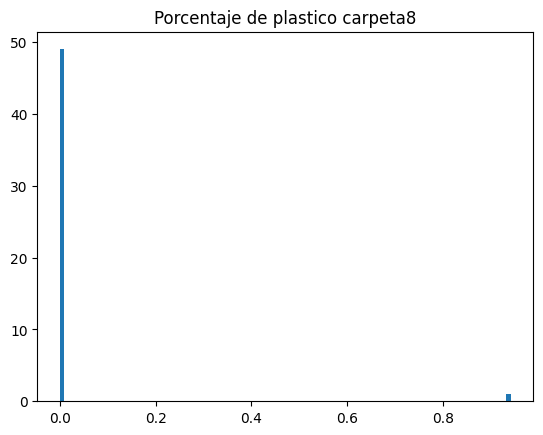

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

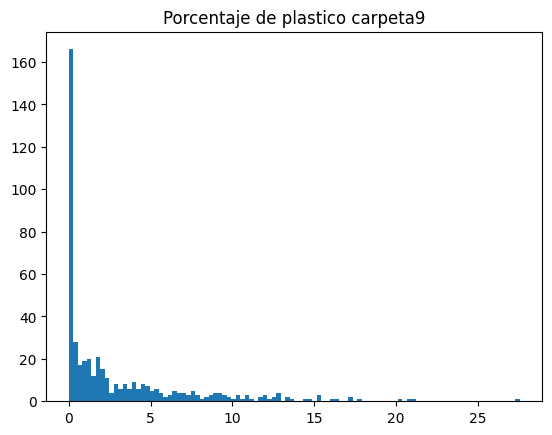

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

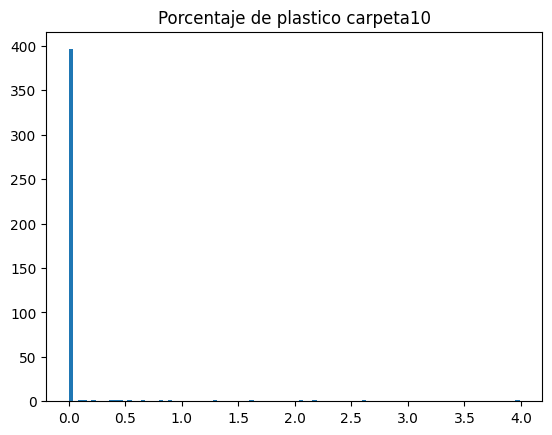

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

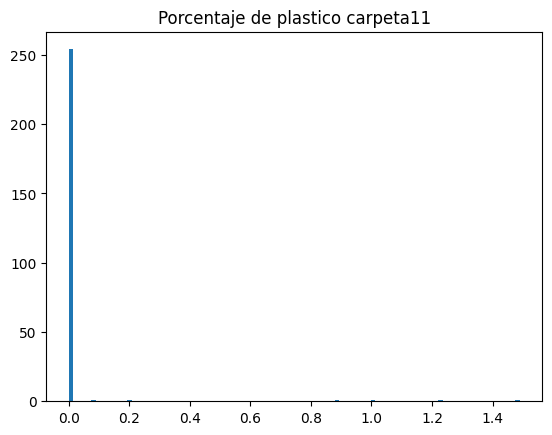

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

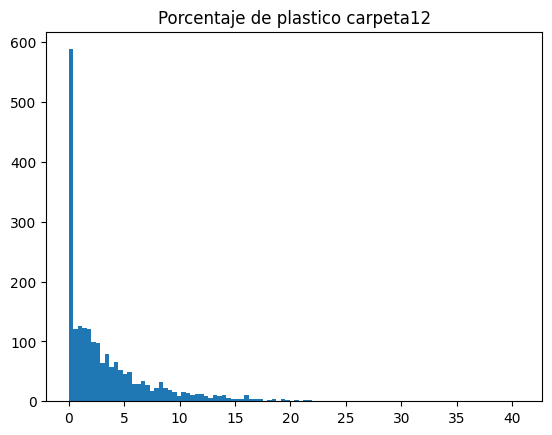

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

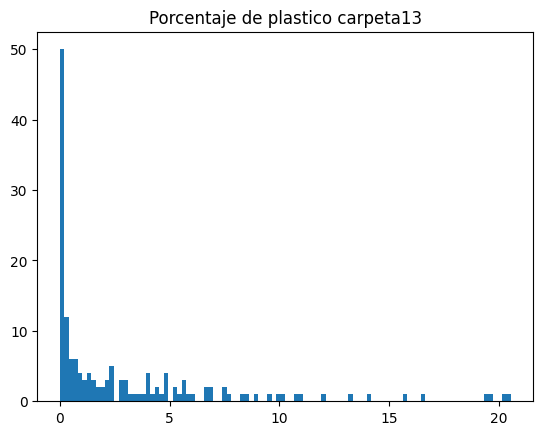

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

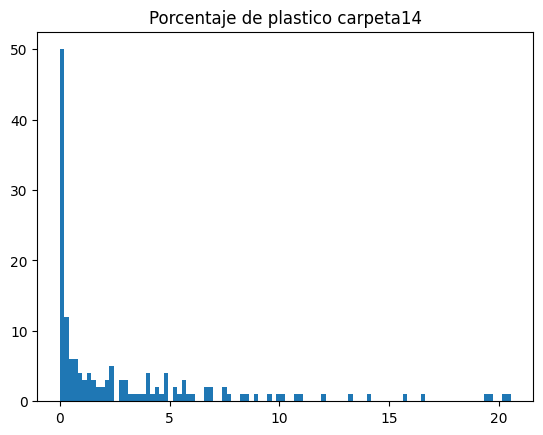

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

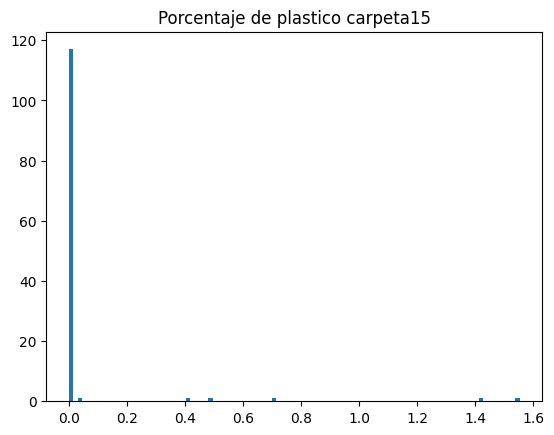

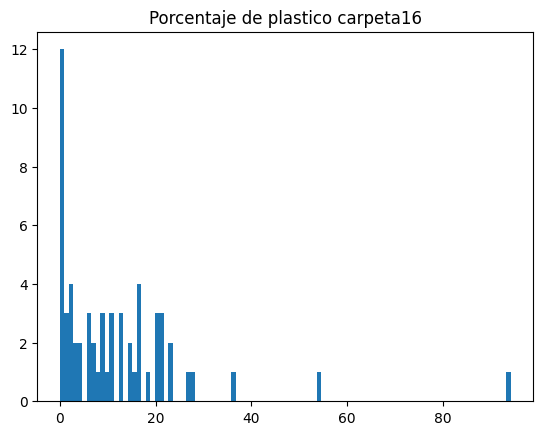

In [53]:
# hacemos lo mismo para la carpeta7
porcentaje_carpeta7 = porcentajes_materiales(puros, carpeta7[0])
plt.hist(porcentaje_carpeta7['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta7')
plt.show()

# hacemos lo mismo para la carpeta8
porcentaje_carpeta8 = porcentajes_materiales(puros, carpeta8[0])
plt.hist(porcentaje_carpeta8['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta8')
plt.show()

# hacemos lo mismo para la carpeta9
porcentaje_carpeta9 = porcentajes_materiales(puros, carpeta9[0])
plt.hist(porcentaje_carpeta9['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta9')
plt.show()

# hacemos lo mismo para la carpeta10
porcentaje_carpeta10 = porcentajes_materiales(puros, carpeta10[0])
plt.hist(porcentaje_carpeta10['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta10')
plt.show()

# hacemos lo mismo para la carpeta11
porcentaje_carpeta11 = porcentajes_materiales(puros, carpeta11[0])
plt.hist(porcentaje_carpeta11['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta11')
plt.show()

# hacemos lo mismo para la carpeta12
porcentaje_carpeta12 = porcentajes_materiales(puros, carpeta12[0])
plt.hist(porcentaje_carpeta12['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta12')
plt.show()

# hacemos lo mismo para la carpeta13
porcentaje_carpeta13 = porcentajes_materiales(puros, carpeta13[0])
plt.hist(porcentaje_carpeta13['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta13')
plt.show()

# hacemos lo mismo para la carpeta14
porcentaje_carpeta14 = porcentajes_materiales(puros, carpeta14[0])
plt.hist(porcentaje_carpeta14['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta14')
plt.show()

# hacemos lo mismo para la carpeta15
porcentaje_carpeta15 = porcentajes_materiales(puros, carpeta15[0])
plt.hist(porcentaje_carpeta15['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta15')
plt.show()

# hacemos lo mismo para la carpeta16
porcentaje_carpeta16 = porcentajes_materiales(puros, carpeta16[0])
plt.hist(porcentaje_carpeta16['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta16')
plt.show()


In [54]:
# Interpolamos todos esos espectros
interpolado_carpeta1 = interpolado(carpeta1[0])
interpolado_carpeta2 = interpolado(carpeta2[0])
interpolado_carpeta3 = interpolado(carpeta3[0])
interpolado_carpeta4 = interpolado(carpeta4[0])
interpolado_carpeta5 = interpolado(carpeta5[0])
interpolado_carpeta6 = interpolado(carpeta6[0])
interpolado_carpeta7 = interpolado(carpeta7[0])
interpolado_carpeta8 = interpolado(carpeta8[0])
interpolado_carpeta9 = interpolado(carpeta9[0])
interpolado_carpeta10 = interpolado(carpeta10[0])
interpolado_carpeta11 = interpolado(carpeta11[0])
interpolado_carpeta12 = interpolado(carpeta12[0])
interpolado_carpeta13 = interpolado(carpeta13[0])
interpolado_carpeta14 = interpolado(carpeta14[0])
interpolado_carpeta15 = interpolado(carpeta15[0])
interpolado_carpeta16 = interpolado(carpeta16[0])

# Suponiendo que ya tienes las variables de porcentaje y espectros interpolados

# Listas de porcentajes y espectros interpolados
porcentaje_list = [
    porcentaje_carpeta1, porcentaje_carpeta2, porcentaje_carpeta3, porcentaje_carpeta4,
    porcentaje_carpeta5, porcentaje_carpeta6, porcentaje_carpeta7, porcentaje_carpeta8,
    porcentaje_carpeta9, porcentaje_carpeta10, porcentaje_carpeta11, porcentaje_carpeta12,
    porcentaje_carpeta13, porcentaje_carpeta14, porcentaje_carpeta15, porcentaje_carpeta16
]

interpolado_list = [
    interpolado_carpeta1, interpolado_carpeta2, interpolado_carpeta3, interpolado_carpeta4,
    interpolado_carpeta5, interpolado_carpeta6, interpolado_carpeta7, interpolado_carpeta8,
    interpolado_carpeta9, interpolado_carpeta10, interpolado_carpeta11, interpolado_carpeta12,
    interpolado_carpeta13, interpolado_carpeta14, interpolado_carpeta15, interpolado_carpeta16
]

# Lista para guardar los espectros interpolados filtrados
UAM588 = []

# Iterar a través de las carpetas
for j in range(16):  # Hay 16 carpetas, índices de 0 a 15
    porcentaje_carpeta = porcentaje_list[j]
    interpolado_carpeta = interpolado_list[j]
    
    # Filtrar los espectros con porcentaje de plástico menor al 3%
    for i in range(len(porcentaje_carpeta)):
        if porcentaje_carpeta['espectroB'].values[i] < 3:
            # Seleccionar el espectro correspondiente y agregarlo a la lista UAM588
            espectro = interpolado_carpeta.iloc[:, i]
            UAM588.append(espectro)

# Convertir la lista a DataFrame si es necesario
UAM588_df = pd.DataFrame(UAM588)
UAM588_df

# HAcemos una función de esto último

def filtrar_plastico(porcentaje_list, interpolado_list):
    # Lista para guardar los espectros interpolados filtrados
    UAM588_espectros = []
    n= len(porcentaje_list)
    

    # Iterar a través de las carpetas
    for j in range(n):  # Hay 16 carpetas, índices de 0 a 15
        porcentaje_carpeta = porcentaje_list[j]
        interpolado_carpeta = interpolado_list[j]

        # Filtrar los espectros con porcentaje de plástico menor al 3%
        for i in range(len(porcentaje_carpeta)):
            if porcentaje_carpeta['espectroB'].values[i] < 3:
                # Seleccionar el espectro correspondiente y agregarlo a la lista UAM588
                espectro = interpolado_carpeta.iloc[:, i]
                UAM588_espectros.append(espectro)

    # Convertir la lista a DataFrame si es necesario
    UAM588_df = pd.DataFrame(UAM588_espectros)

    return UAM588_df



       

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

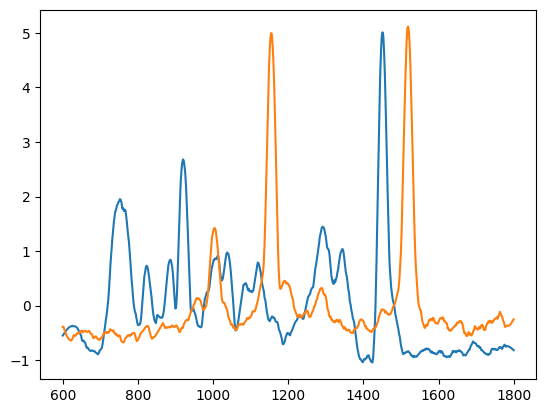

In [55]:
# interpolamos los datos de plastico
interpolado_plastico = interpolado(carpeta_plastico[0])

# interpolamos los datos de UAM588
interpolado_carpeta1 = interpolado(carpeta1[0])

# guardamos dos variables con la muestras de los espectros
plastico = interpolado_plastico.iloc[:, 0]
UAM588 = interpolado_carpeta1.iloc[:, 0]

plt.plot(plastico, label='Plastico')
plt.plot(UAM588, label='UAM588')

In [56]:
def espectro_filtro2(espectroA, espectroB, carpetas_list):
    # Juntamos los dos epectros en un solo DataFrame
    puros = pd.concat([espectroA, espectroB], axis=1)
    puros.columns = ['espectroA', 'espectroB']
    puros = puros.T

    interpolado_list = []
    porcentaje_list = []
    for i in range(len(carpetas_list)):
        porcentaje_list.append(porcentajes_materiales(puros, carpetas_list[i]))
        interpolado_list.append(interpolado(carpetas_list[i]))

    espectros_filtrados = filtrar_plastico(porcentaje_list, interpolado_list)
    return espectros_filtrados

# Lista de carpetas
carpetas_list = [carpeta1[0], carpeta2[0], carpeta3[0], carpeta4[0], carpeta5[0], carpeta6[0], carpeta7[0], carpeta8[0], carpeta9[0], carpeta10[0], carpeta11[0], carpeta12[0], carpeta13[0], carpeta14[0], carpeta15[0], carpeta16[0]]

# Filtrar los espectros
UAM588 = espectro_filtro2(UAM588, plastico, carpetas_list)
    
print(UAM588)



C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

                 600       601       602       603       604       605   \
Spectrum_1  -0.387397 -0.387397 -0.388703 -0.411616 -0.434530 -0.455118   
Spectrum_2  -0.356808 -0.356808 -0.356801 -0.356669 -0.356538 -0.356633   
Spectrum_3  -0.276028 -0.276028 -0.276437 -0.283611 -0.290784 -0.297395   
Spectrum_4  -0.313070 -0.313070 -0.313027 -0.312269 -0.311511 -0.310979   
Spectrum_5  -0.186593 -0.186593 -0.186743 -0.189376 -0.192009 -0.194502   
...               ...       ...       ...       ...       ...       ...   
Spectrum_50 -0.262343 -0.264962 -0.268091 -0.271236 -0.274388 -0.277555   
Spectrum_51 -0.261326 -0.263734 -0.266611 -0.269499 -0.272390 -0.275290   
Spectrum_56 -0.345661 -0.356627 -0.369729 -0.381883 -0.393660 -0.404660   
Spectrum_57 -0.470996 -0.471698 -0.472538 -0.473455 -0.474403 -0.475415   
Spectrum_60 -0.400629 -0.408853 -0.418679 -0.427960 -0.437025 -0.445645   

                 606       607       608       609   ...      1791      1792  \
Spectrum_1  -0.4755

In [57]:
interpolado_carpeta502_1 = interpolado(carpeta502_1[0])
UAM502 = interpolado_carpeta502_1.iloc[:, 0]



carpeta502_list = [carpeta502_1[0], carpeta502_2[0], carpeta502_3[0], carpeta502_4[0], carpeta502_5[0], carpeta502_6[0], carpeta502_7[0], carpeta502_8[0], carpeta502_9[0], carpeta502_10[0], carpeta502_11[0], carpeta502_12[0], carpeta502_13[0], carpeta502_14[0], carpeta502_15[0], carpeta502_16[0], carpeta502_17[0]] 

UAM502 = espectro_filtro2(UAM502, plastico, carpeta502_list)

print(UAM502)

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

                  600       601       602       603       604       605   \
Spectrum_1   -0.237699 -0.237699 -0.238590 -0.241868 -0.245142 -0.248394   
Spectrum_2   -0.415791 -0.415791 -0.415868 -0.416151 -0.416435 -0.416728   
Spectrum_3   -0.313510 -0.313510 -0.312688 -0.309665 -0.306756 -0.304478   
Spectrum_5   -0.343932 -0.343932 -0.345938 -0.353311 -0.360625 -0.367614   
Spectrum_6   -0.133190 -0.133190 -0.138611 -0.158541 -0.178236 -0.196634   
...                ...       ...       ...       ...       ...       ...   
Spectrum_670 -0.621984 -0.617620 -0.610148 -0.602917 -0.595963 -0.589174   
Spectrum_671 -0.606718 -0.605745 -0.604080 -0.602402 -0.600709 -0.599004   
Spectrum_672 -0.411326 -0.410591 -0.409332 -0.408216 -0.407266 -0.406419   
Spectrum_673 -0.419586 -0.417607 -0.414218 -0.411132 -0.408393 -0.405871   
Spectrum_674 -0.216309 -0.219451 -0.224831 -0.229942 -0.234743 -0.239356   

                  606       607       608       609   ...      1791      1792  \
Spectr

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

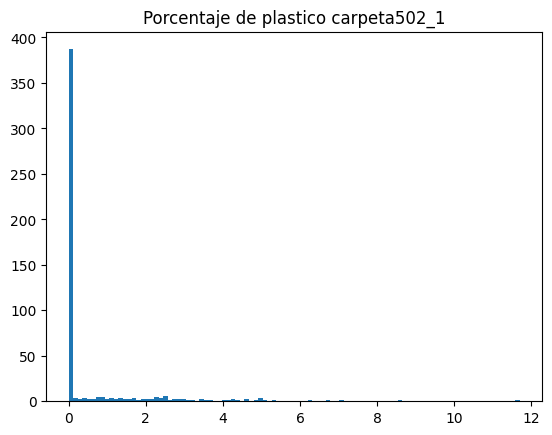

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

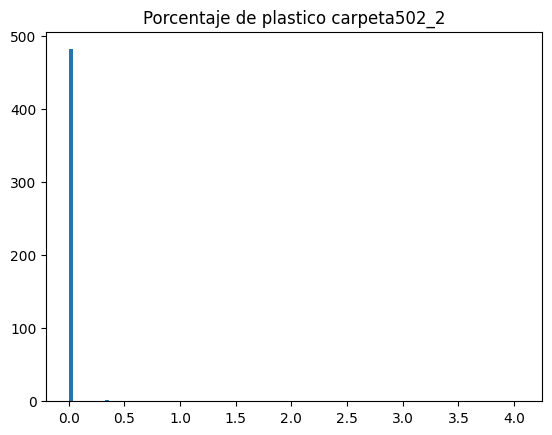

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

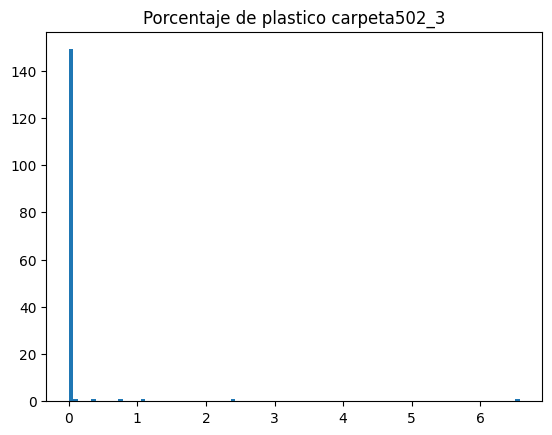

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

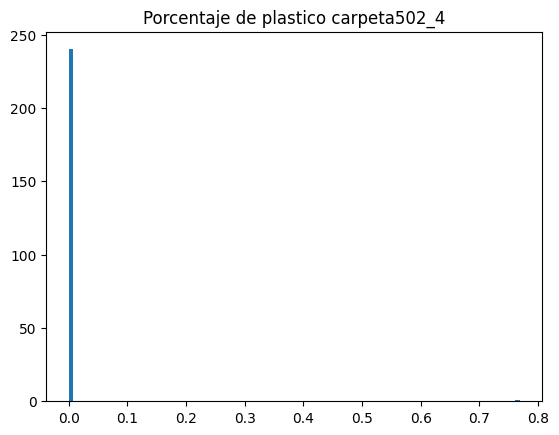

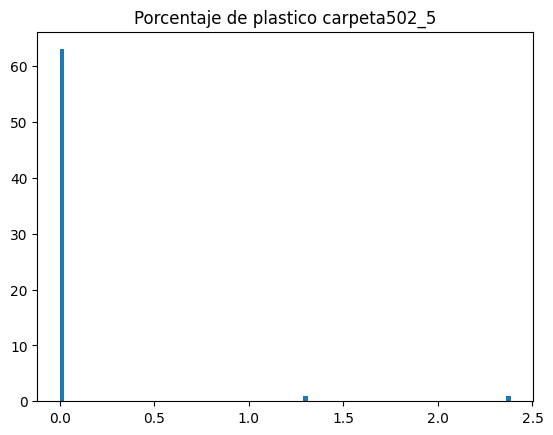

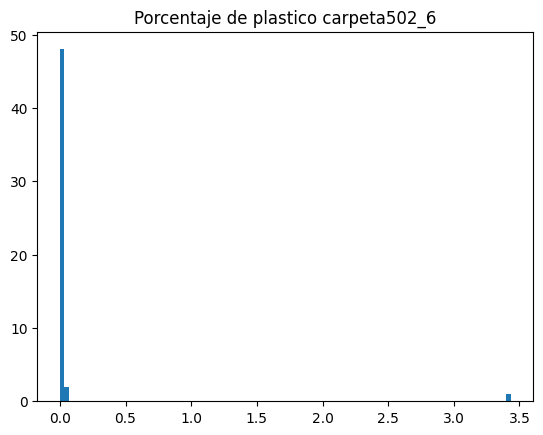

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

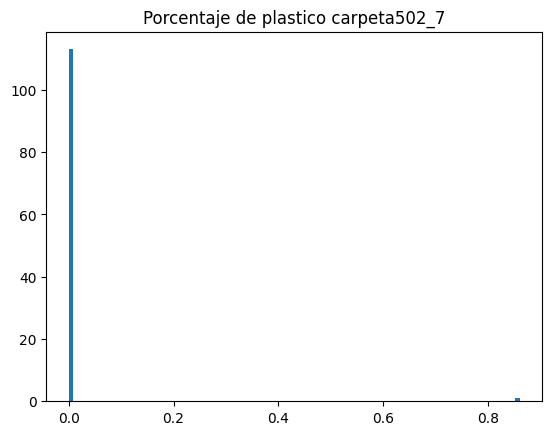

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

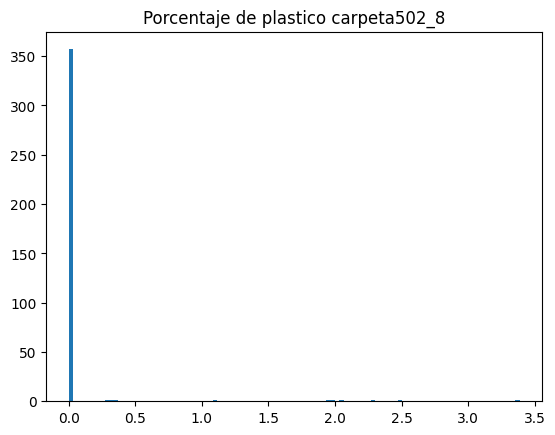

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

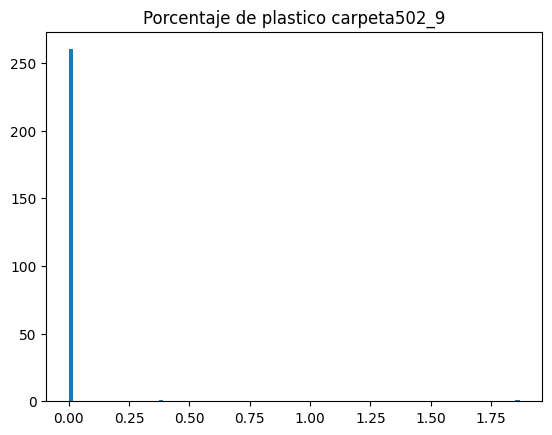

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

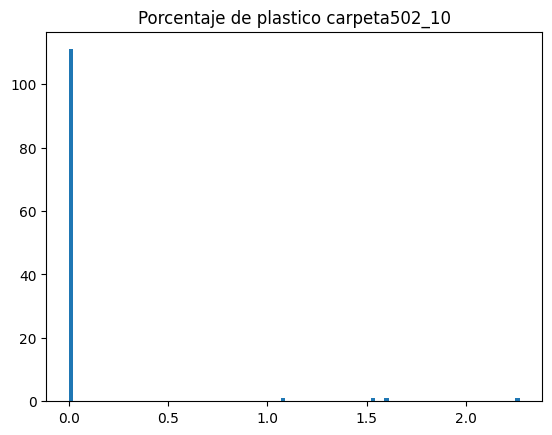

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

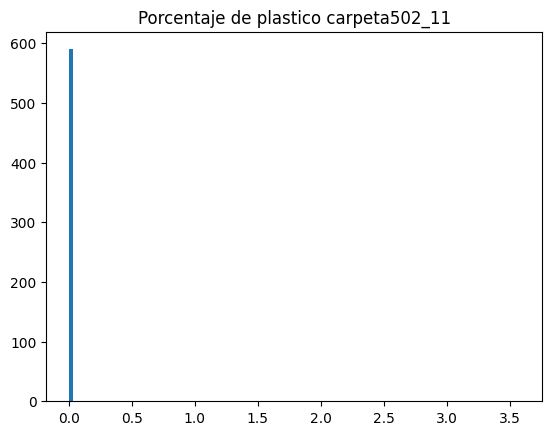

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

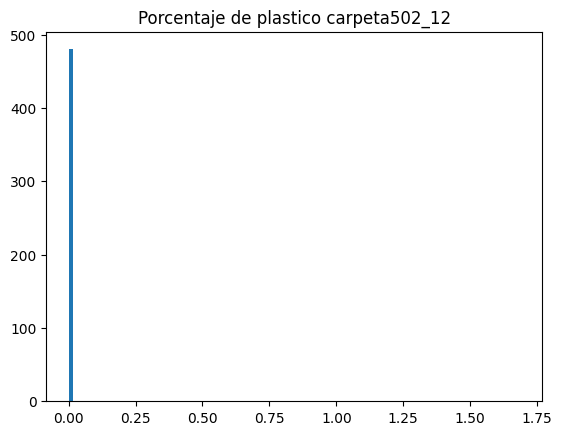

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

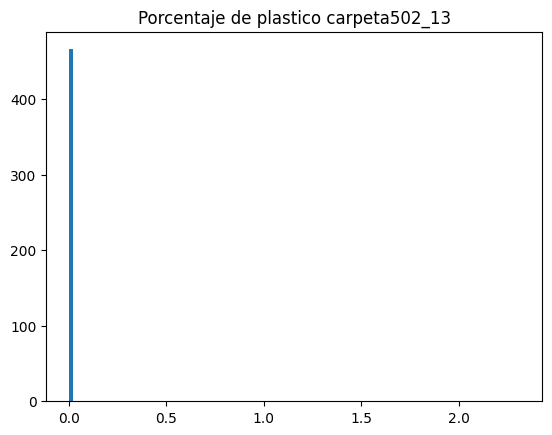

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

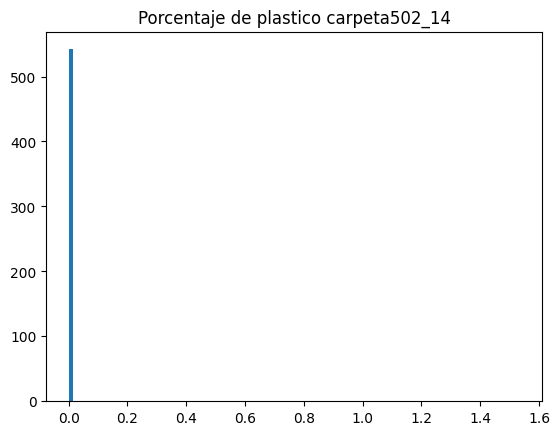

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

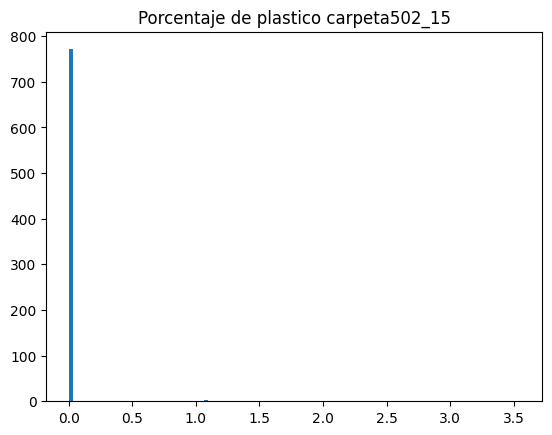

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

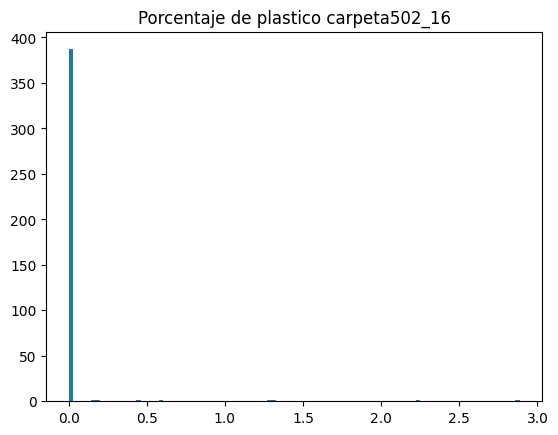

C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

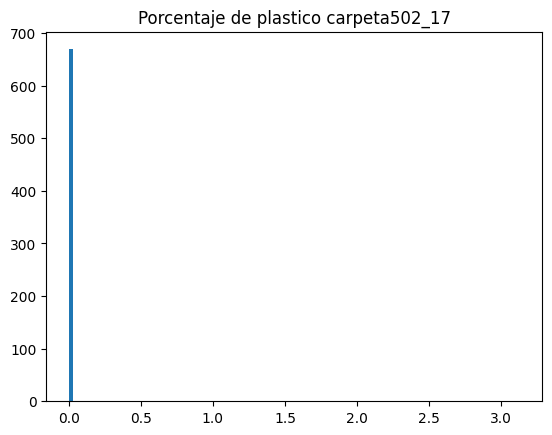

In [58]:
porcentaje_carpeta502_1 = porcentajes_materiales(puros, carpeta502_1[0])
plt.hist(porcentaje_carpeta502_1['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta502_1')
plt.show()


porcentaje_carpeta502_2 = porcentajes_materiales(puros, carpeta502_2[0])
plt.hist(porcentaje_carpeta502_2['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta502_2')
plt.show()

porcentaje_carpeta502_3 = porcentajes_materiales(puros, carpeta502_3[0])
plt.hist(porcentaje_carpeta502_3['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta502_3')
plt.show()

porcentaje_carpeta502_4 = porcentajes_materiales(puros, carpeta502_4[0])
plt.hist(porcentaje_carpeta502_4['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta502_4')
plt.show()

porcentaje_carpeta502_5 = porcentajes_materiales(puros, carpeta502_5[0])
plt.hist(porcentaje_carpeta502_5['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta502_5')
plt.show()

porcentaje_carpeta502_6 = porcentajes_materiales(puros, carpeta502_6[0])
plt.hist(porcentaje_carpeta502_6['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta502_6')
plt.show()

porcentaje_carpeta502_7 = porcentajes_materiales(puros, carpeta502_7[0])
plt.hist(porcentaje_carpeta502_7['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta502_7')
plt.show()

porcentaje_carpeta502_8 = porcentajes_materiales(puros, carpeta502_8[0])
plt.hist(porcentaje_carpeta502_8['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta502_8')
plt.show()

porcentaje_carpeta502_9 = porcentajes_materiales(puros, carpeta502_9[0])
plt.hist(porcentaje_carpeta502_9['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta502_9')
plt.show()

porcentaje_carpeta502_10 = porcentajes_materiales(puros, carpeta502_10[0])
plt.hist(porcentaje_carpeta502_10['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta502_10')
plt.show()

porcentaje_carpeta502_11 = porcentajes_materiales(puros, carpeta502_11[0])
plt.hist(porcentaje_carpeta502_11['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta502_11')
plt.show()

porcentaje_carpeta502_12 = porcentajes_materiales(puros, carpeta502_12[0])
plt.hist(porcentaje_carpeta502_12['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta502_12')
plt.show()

porcentaje_carpeta502_13 = porcentajes_materiales(puros, carpeta502_13[0])
plt.hist(porcentaje_carpeta502_13['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta502_13')
plt.show()

porcentaje_carpeta502_14 = porcentajes_materiales(puros, carpeta502_14[0])
plt.hist(porcentaje_carpeta502_14['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta502_14')
plt.show()

porcentaje_carpeta502_15 = porcentajes_materiales(puros, carpeta502_15[0])
plt.hist(porcentaje_carpeta502_15['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta502_15')
plt.show()

porcentaje_carpeta502_16 = porcentajes_materiales(puros, carpeta502_16[0])
plt.hist(porcentaje_carpeta502_16['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta502_16')
plt.show()

porcentaje_carpeta502_17 = porcentajes_materiales(puros, carpeta502_17[0])
plt.hist(porcentaje_carpeta502_17['espectroB'].values.astype(float), bins=100)
plt.title('Porcentaje de plastico carpeta502_17')
plt.show()







In [59]:
type(UAM502)
type(UAM588)

pandas.core.frame.DataFrame

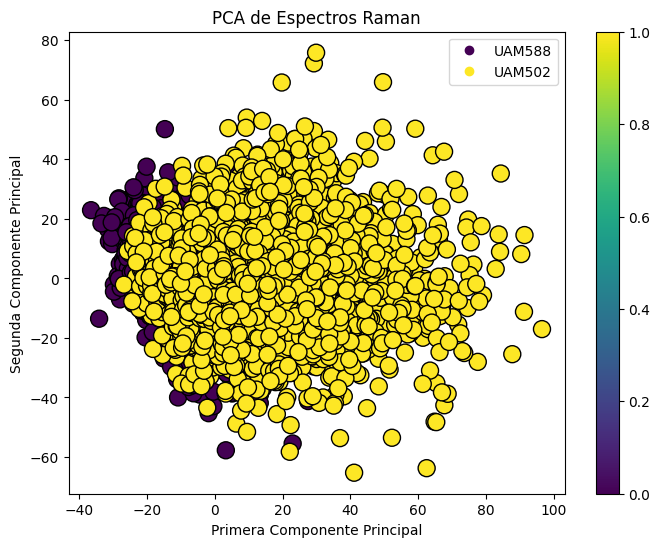

Varianza explicada por cada componente principal: [0.27534841 0.13655408]


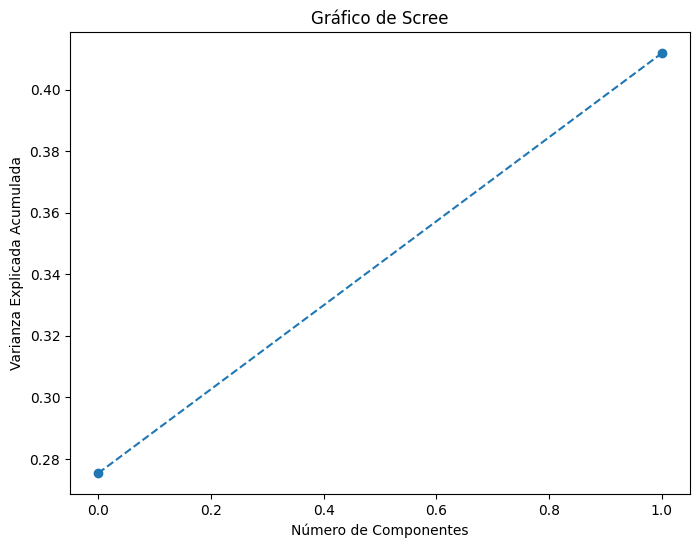

In [60]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler


# Crear etiquetas para las especies
labels_588 = np.zeros(UAM588.shape[0])
labels_502 = np.ones(UAM502.shape[0])

# Combinar los datos y las etiquetas
X = np.vstack((UAM588, UAM502))
y = np.hstack((labels_588, labels_502))

# Estandarizar los datos
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Aplicar PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

# Visualizar los resultados
plt.figure(figsize=(8, 6))
scatter = plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y, cmap='viridis', edgecolor='k', s=150)
plt.xlabel('Primera Componente Principal')
plt.ylabel('Segunda Componente Principal')
plt.title('PCA de Espectros Raman')
plt.legend(handles=scatter.legend_elements()[0], labels=['UAM588', 'UAM502'])
plt.colorbar()
plt.show()

# Varianza explicada
explained_variance = pca.explained_variance_ratio_
print("Varianza explicada por cada componente principal:", explained_variance)

# Gráfico de Scree
plt.figure(figsize=(8, 6))
plt.plot(np.cumsum(pca.explained_variance_ratio_), marker='o', linestyle='--')
plt.xlabel('Número de Componentes')
plt.ylabel('Varianza Explicada Acumulada')
plt.title('Gráfico de Scree')
plt.show()


Precisión: 0.94
              precision    recall  f1-score   support

      UAM502       0.93      0.96      0.95       884
      UAM588       0.95      0.91      0.93       692

    accuracy                           0.94      1576
   macro avg       0.94      0.94      0.94      1576
weighted avg       0.94      0.94      0.94      1576

[[853  31]
 [ 62 630]]
Importancia de las características:
1. 1780: 0.0314
2. 1792: 0.0297
3. 1774: 0.0288
4. 1779: 0.0272
5. 1785: 0.0266
6. 1788: 0.0248
7. 1782: 0.0241
8. 1783: 0.0202
9. 1790: 0.0201
10. 1791: 0.0189
11. 1776: 0.0187
12. 1793: 0.0187
13. 1787: 0.0173
14. 1767: 0.0158
15. 1751: 0.0139
16. 1775: 0.0122
17. 1761: 0.0121
18. 1763: 0.0115
19. 1796: 0.0114
20. 1768: 0.0110
21. 1786: 0.0103
22. 1784: 0.0100
23. 1757: 0.0095
24. 1739: 0.0090
25. 1738: 0.0087
26. 1781: 0.0079
27. 1789: 0.0078
28. 1794: 0.0077
29. 1778: 0.0069
30. 1760: 0.0066
31. 1795: 0.0063
32. 1770: 0.0060
33. 1799: 0.0056
34. 1764: 0.0056
35. 1765: 0.0056
36. 1766: 0.

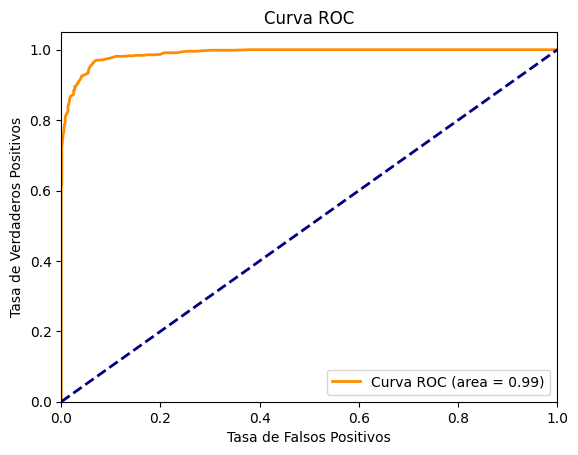

In [61]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_curve, auc
from sklearn.preprocessing import LabelEncoder
import matplotlib.pyplot as plt
UAM588_2= UAM588.copy()
UAM502_2= UAM502.copy() 
# Añadimos una columna para indicar la especie
UAM588_2['species'] = 'UAM588'
UAM502_2['species'] = 'UAM502'

# Combinamos los DataFrames
data = pd.concat([UAM588_2, UAM502_2], ignore_index=True)

# Convertimos las etiquetas de las especies a valores numéricos
label_encoder = LabelEncoder()
data['species'] = label_encoder.fit_transform(data['species'])

# Separar características y etiquetas
X = data.drop(columns=['species'])
y = data['species']

# Dividir en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Crear el modelo Random Forest
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)

# Entrenar el modelo
rf_model.fit(X_train, y_train)

# Hacer predicciones en el conjunto de prueba
y_pred = rf_model.predict(X_test)
y_prob = rf_model.predict_proba(X_test)[:, 1]  # Probabilidades para la curva ROC

# Calcular la precisión del modelo
accuracy = accuracy_score(y_test, y_pred)
print(f'Precisión: {accuracy:.2f}')

# Mostrar el informe de clasificación
print(classification_report(y_test, y_pred, target_names=label_encoder.classes_))

# Mostrar la matriz de confusión
print(confusion_matrix(y_test, y_pred))

# Importancia de las características
importances = rf_model.feature_importances_
indices = np.argsort(importances)[::-1]
feature_names = X.columns

print("Importancia de las características:")
for f in range(X.shape[1]):
    print(f"{f + 1}. {feature_names[indices[f]]}: {importances[indices[f]]:.4f}")

# Curva ROC
fpr, tpr, _ = roc_curve(y_test, y_prob)
roc_auc = auc(fpr, tpr)

plt.figure()
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'Curva ROC (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('Tasa de Falsos Positivos')
plt.ylabel('Tasa de Verdaderos Positivos')
plt.title('Curva ROC')
plt.legend(loc="lower right")
plt.show()


In [62]:
from sklearn.svm import SVC
# Inicializar el clasificador SVM
svm_classifier = SVC(kernel='rbf', gamma='scale', random_state=42)

# Entrenar el modelo SVM
svm_classifier.fit(X_train, y_train)

# Predecir en el conjunto de prueba
y_pred_svm = svm_classifier.predict(X_test)

# Evaluar el modelo SVM
print("Resultados SVM:")
print(confusion_matrix(y_test, y_pred_svm))
print(classification_report(y_test, y_pred_svm))


Resultados SVM:
[[840  44]
 [ 68 624]]
              precision    recall  f1-score   support

           0       0.93      0.95      0.94       884
           1       0.93      0.90      0.92       692

    accuracy                           0.93      1576
   macro avg       0.93      0.93      0.93      1576
weighted avg       0.93      0.93      0.93      1576



In [63]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from sklearn.preprocessing import StandardScaler

# Normalizar los datos (escalarlos) para la red neuronal
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Dividir los datos escalados en conjunto de entrenamiento y prueba
X_train_scaled, X_test_scaled, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)


In [64]:
# Inicializar la red neuronal
model = Sequential([
    Dense(64, activation='relu', input_shape=(X_train_scaled.shape[1],)),
    Dense(32, activation='relu'),
    Dense(1, activation='sigmoid')
])

# Compilar el modelo
model.compile(optimizer='adam',
              loss='binary_crossentropy',
              metrics=['accuracy'])

# Entrenar el modelo
history = model.fit(X_train_scaled, y_train, epochs=50, batch_size=32, validation_split=0.2, verbose=1)

# Evaluar el modelo en el conjunto de prueba
y_pred_nn = (model.predict(X_test_scaled) > 0.5).astype("int32")  # Convertir las probabilidades a clases binarias

# Mostrar métricas de evaluación
print("\nResultados Red Neuronal:")
print(confusion_matrix(y_test, y_pred_nn))
print(classification_report(y_test, y_pred_nn))


Epoch 1/50
158/158 [==============================] - 1s 4ms/step - loss: 0.1660 - accuracy: 0.9338 - val_loss: 0.1390 - val_accuracy: 0.9413
Epoch 2/50
158/158 [==============================] - 0s 3ms/step - loss: 0.0927 - accuracy: 0.9631 - val_loss: 0.1145 - val_accuracy: 0.9469
Epoch 3/50
158/158 [==============================] - 0s 3ms/step - loss: 0.0644 - accuracy: 0.9764 - val_loss: 0.1359 - val_accuracy: 0.9437
Epoch 4/50
158/158 [==============================] - 0s 3ms/step - loss: 0.0548 - accuracy: 0.9768 - val_loss: 0.1180 - val_accuracy: 0.9580
Epoch 5/50
158/158 [==============================] - 0s 3ms/step - loss: 0.0352 - accuracy: 0.9855 - val_loss: 0.1214 - val_accuracy: 0.9572
Epoch 6/50
158/158 [==============================] - 0s 3ms/step - loss: 0.0359 - accuracy: 0.9881 - val_loss: 0.1167 - val_accuracy: 0.9580
Epoch 7/50
158/158 [==============================] - 0s 3ms/step - loss: 0.0250 - accuracy: 0.9911 - val_loss: 0.1095 - val_accuracy: 0.9611
Epoch 

In [65]:
ruta1_253= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM253\UAM253\110624_UAM253_1s_1acc_pwmuesca1_5um_1"
ruta2_253= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM253\UAM253\110624_UAM253_1s_1acc_pwmuesca1_7um_2"
ruta3_253= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM253\UAM253\110624_UAM253_1s_1acc_pwmuesca1_10um_3"
ruta4_253= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM253\UAM253\120624_UAM253_1s_1acc_pwmuesca1_5um_5"
ruta5_253= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM253\UAM253\120624_UAM253_1s_1acc_pwmuesca1_10um_4"
ruta6_253= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM253\UAM253\120624_UAM253_1s_1acc_pwmuesca1_10um_6"
ruta7_253= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM253\UAM253\120624_UAM253_1s_1acc_pwras_5um_9"
ruta9_253= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM253\UAM253\120624_UAM253_1s_1acc_pwras_5um_10"
ruta10_253= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM253\UAM253\120624_UAM253_2s_1acc_pwmuesca1_10um_7"
ruta11_253= r"C:\Users\pc\Desktop\Segundo Cuatri\TFM\TFMjorge\TFMjorge\UAM253\UAM253\120624_UAM253_2s_1acc_pwmuesca1_10um_8"



esto el que hay en  ['110624_UAM253_1s_1acc_pwmuesca1_5um_1.CSV']
Procesando 110624_UAM253_1s_1acc_pwmuesca1_5um_1.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


110624_UAM253_1s_1acc_pwmuesca1_5um_1.CSV: se descartaron 0 espectros saturados de un total de 9471 espectros.


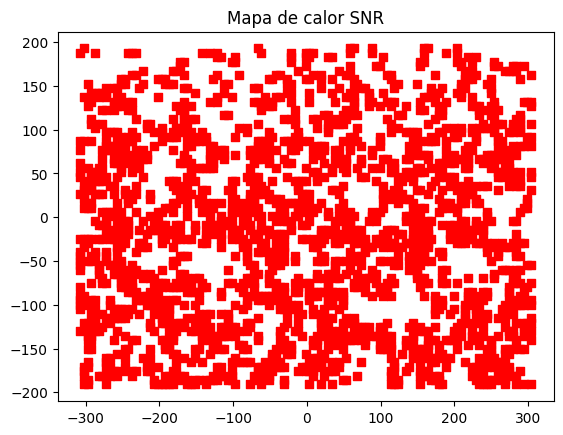

No image file containing 'PRE' found in the specified directory.


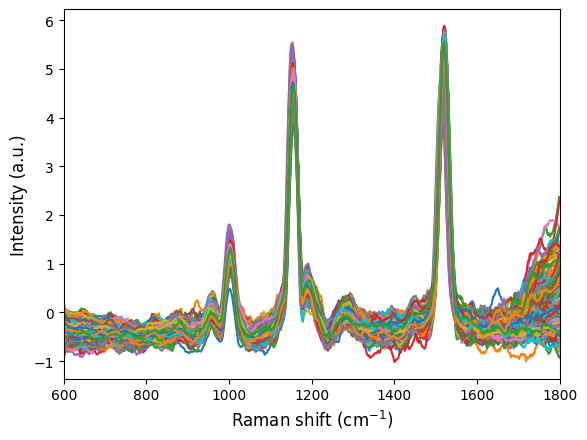

In [66]:
carpeta1_253 = SNR(ruta1_253, 'no', 'no', 'si')

esto el que hay en  ['110624_UAM253_1s_1acc_pwmuesca1_7um_2.CSV']
Procesando 110624_UAM253_1s_1acc_pwmuesca1_7um_2.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


110624_UAM253_1s_1acc_pwmuesca1_7um_2.CSV: se descartaron 1 espectros saturados de un total de 5922 espectros.


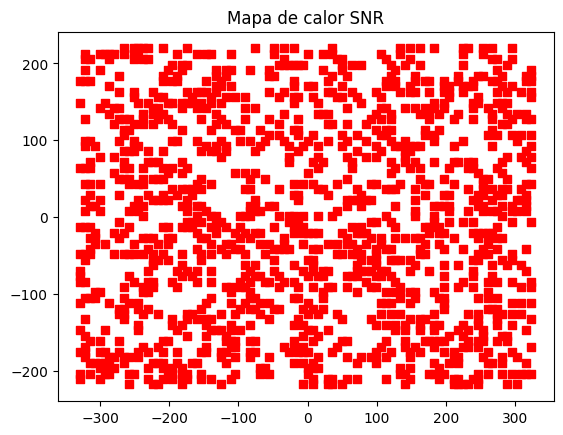

No image file containing 'PRE' found in the specified directory.


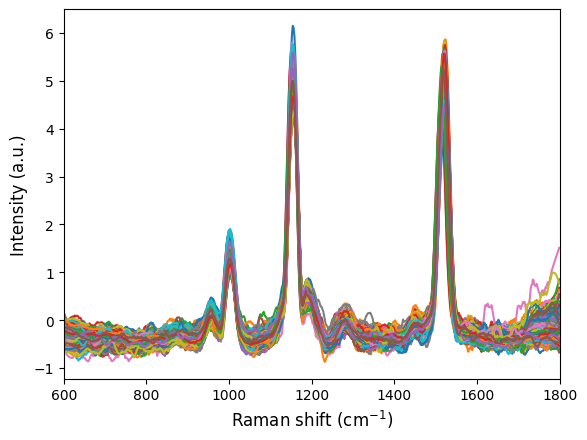

In [67]:
carpeta2_253 = SNR(ruta2_253, 'no', 'no', 'si')

esto el que hay en  ['120624_UAM253_1s_1acc_pwmuesca1_10um_3.CSV']
Procesando 120624_UAM253_1s_1acc_pwmuesca1_10um_3.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


120624_UAM253_1s_1acc_pwmuesca1_10um_3.CSV: se descartaron 2 espectros saturados de un total de 2904 espectros.


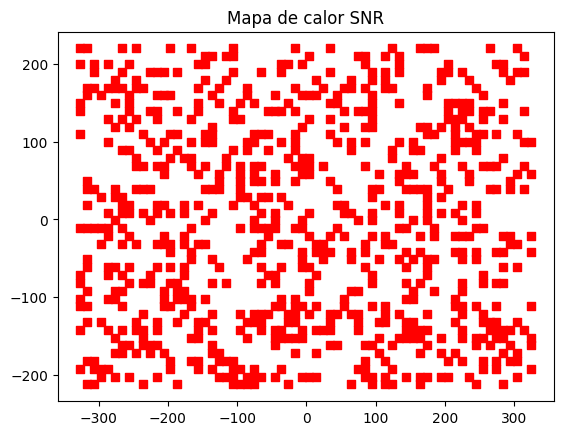

No image file containing 'PRE' found in the specified directory.


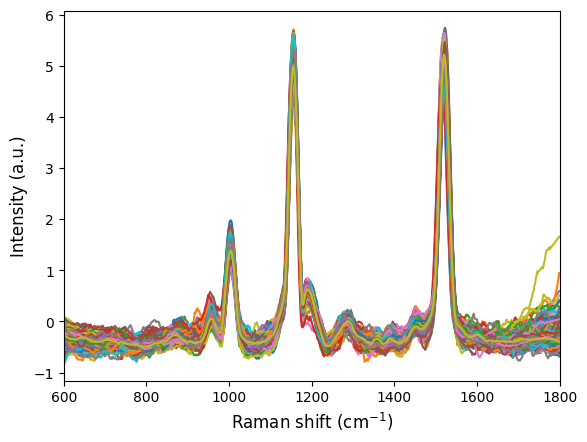

In [68]:
carpeta3_253 = SNR(ruta3_253, 'no', 'no', 'si')

esto el que hay en  ['120624_UAM253_1s_1acc_pwmuesca1_5um_5.CSV']
Procesando 120624_UAM253_1s_1acc_pwmuesca1_5um_5.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


120624_UAM253_1s_1acc_pwmuesca1_5um_5.CSV: se descartaron 0 espectros saturados de un total de 11528 espectros.


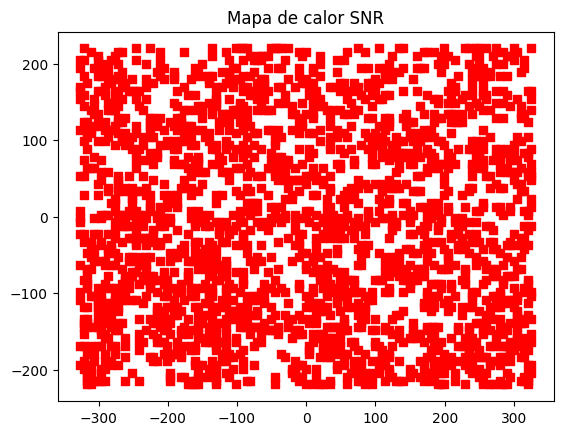

No image file containing 'PRE' found in the specified directory.


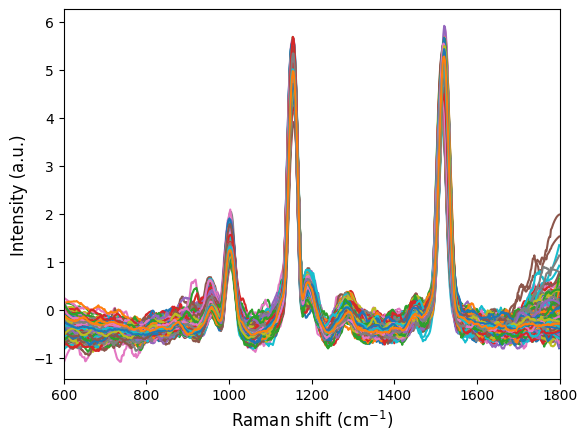

In [69]:
carpeta4_253 = SNR(ruta4_253, 'no', 'no', 'si')

esto el que hay en  ['120624_UAM253_1s_1acc_pwmuesca1_10um_4.CSV']
Procesando 120624_UAM253_1s_1acc_pwmuesca1_10um_4.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


120624_UAM253_1s_1acc_pwmuesca1_10um_4.CSV: se descartaron 0 espectros saturados de un total de 2904 espectros.


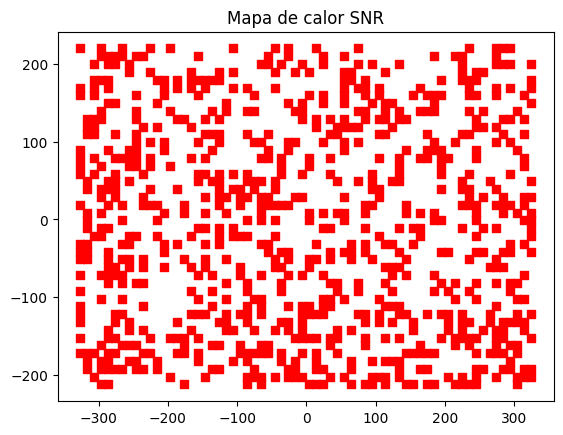

No image file containing 'PRE' found in the specified directory.


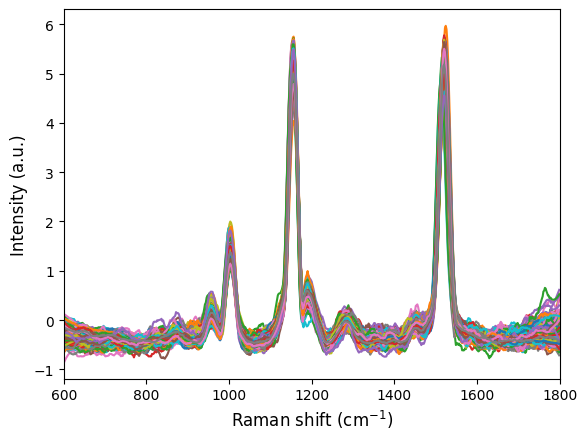

In [70]:
carpeta5_253 = SNR(ruta5_253, 'no', 'no', 'si')

esto el que hay en  ['120624_UAM253_1s_1acc_pwmuesca1_10um_6.CSV']
Procesando 120624_UAM253_1s_1acc_pwmuesca1_10um_6.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


120624_UAM253_1s_1acc_pwmuesca1_10um_6.CSV: se descartaron 1 espectros saturados de un total de 2904 espectros.


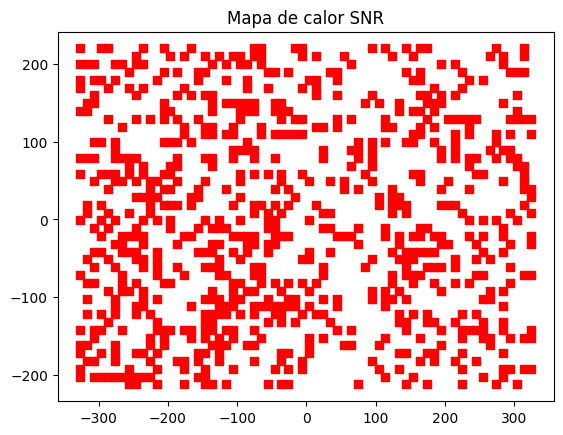

No image file containing 'PRE' found in the specified directory.


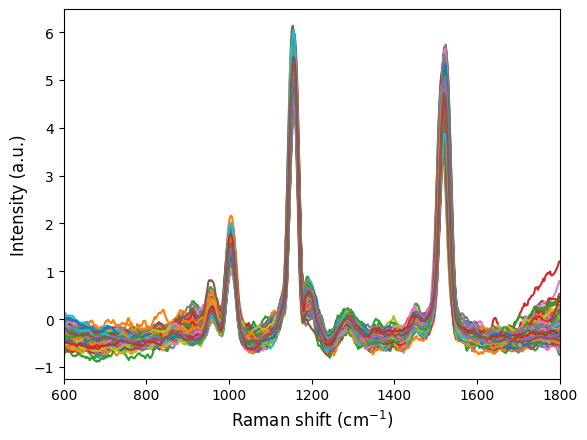

In [71]:
carpeta6_253 = SNR(ruta6_253, 'no', 'no', 'si')

esto el que hay en  ['120624_UAM253_1s_1acc_pwras_5um_9.CSV']
Procesando 120624_UAM253_1s_1acc_pwras_5um_9.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


120624_UAM253_1s_1acc_pwras_5um_9.CSV: se descartaron 2 espectros saturados de un total de 11528 espectros.


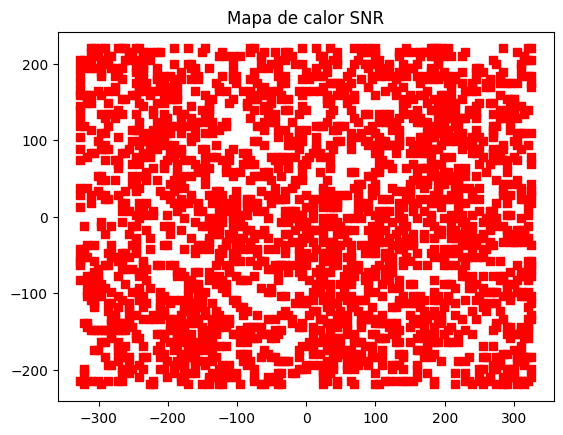

No image file containing 'PRE' found in the specified directory.


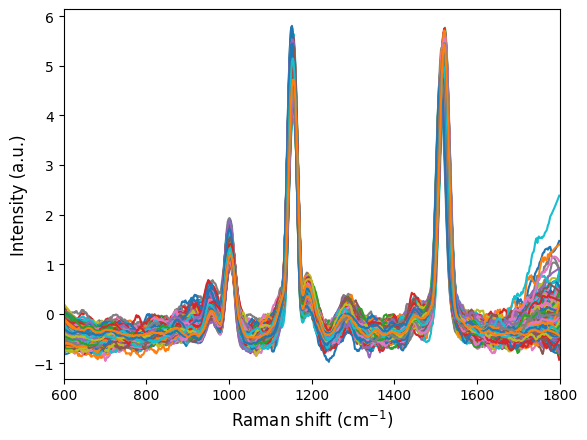

In [72]:
carpeta7_253 = SNR(ruta7_253, 'no', 'no', 'si')

esto el que hay en  ['120624_UAM253_1s_1acc_pwras_5um_10.CSV']
Procesando 120624_UAM253_1s_1acc_pwras_5um_10.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


120624_UAM253_1s_1acc_pwras_5um_10.CSV: se descartaron 0 espectros saturados de un total de 6075 espectros.


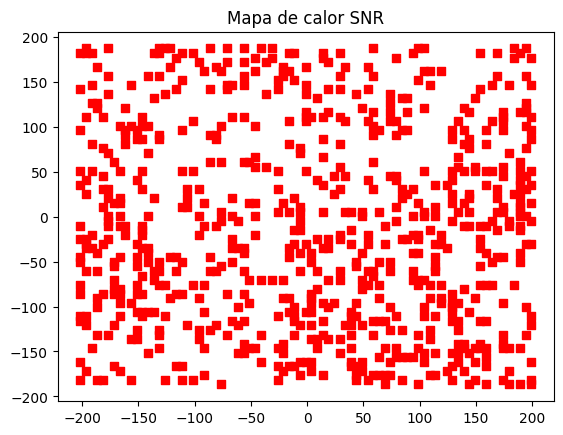

No image file containing 'PRE' found in the specified directory.


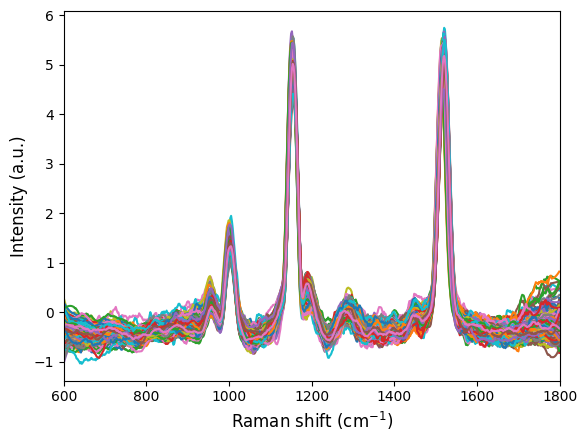

In [73]:
carpeta9_253 = SNR(ruta9_253, 'no', 'no', 'si')

esto el que hay en  ['120624_UAM253_2s_1acc_pwmuesca1_10um_7.CSV']
Procesando 120624_UAM253_2s_1acc_pwmuesca1_10um_7.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


120624_UAM253_2s_1acc_pwmuesca1_10um_7.CSV: se descartaron 7 espectros saturados de un total de 2904 espectros.


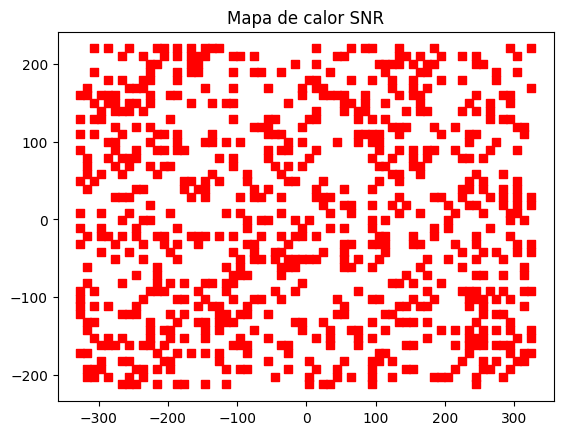

No image file containing 'PRE' found in the specified directory.


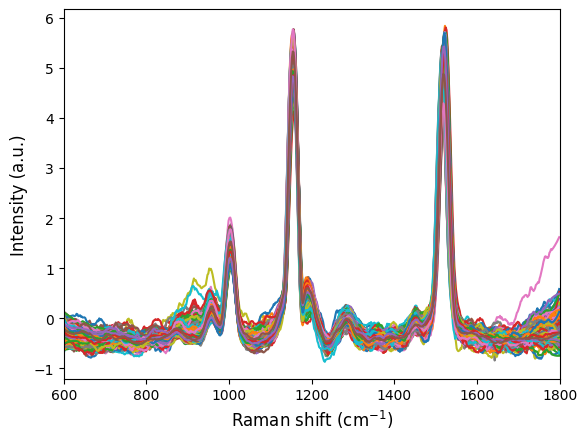

In [74]:
carpeta10_253 = SNR(ruta10_253, 'no', 'no', 'si')

esto el que hay en  ['120624_UAM253_2s_1acc_pwmuesca1_10um_8.CSV']
Procesando 120624_UAM253_2s_1acc_pwmuesca1_10um_8.CSV...


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\831990641.py:56: FutureWarning: In a future version of pandas all arguments of DataFrame.any and Series.any will be keyword-only.
  indices = D.index[D.gt(65000).any(1)]


120624_UAM253_2s_1acc_pwmuesca1_10um_8.CSV: se descartaron 13 espectros saturados de un total de 2904 espectros.


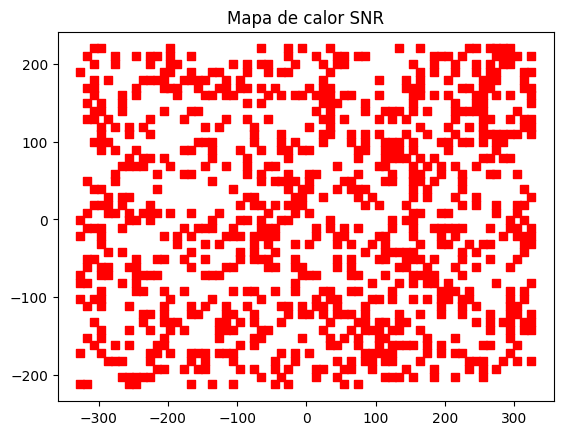

No image file containing 'PRE' found in the specified directory.


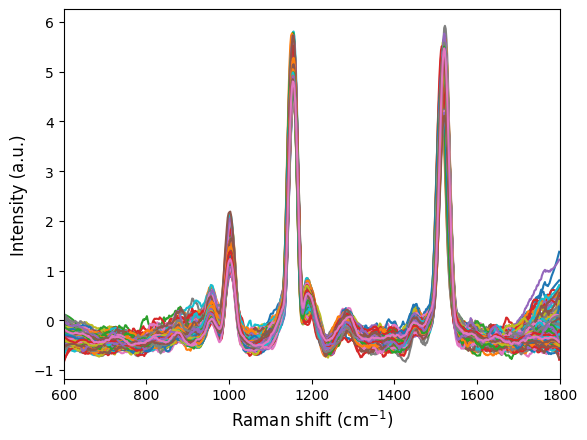

In [75]:
carpeta11_253 = SNR(ruta11_253, 'no', 'no', 'si')

In [76]:
# Calculamos el numero de espectros de UAM253
numero_espectros_253 = len(carpeta1_253[0]) + len(carpeta2_253[0]) + len(carpeta3_253[0]) + len(carpeta4_253[0]) + len(carpeta5_253[0]) + len(carpeta6_253[0]) + len(carpeta7_253[0]) + len(carpeta9_253[0]) + len(carpeta10_253[0]) + len(carpeta11_253[0])

print(numero_espectros_253)

12406


In [77]:
interpolado_carpeta1_253 = interpolado(carpeta1_253[0])
UAM253=interpolado_carpeta1_253.iloc[:, 0] 

carpeta253_list = [carpeta1_253[0], carpeta2_253[0], carpeta3_253[0], carpeta4_253[0], carpeta5_253[0], carpeta6_253[0], carpeta7_253[0], carpeta9_253[0], carpeta10_253[0], carpeta11_253[0]]

UAM253 = espectro_filtro2(UAM253, plastico, carpeta253_list)
print(UAM253)


C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolated_df[f'Spectrum_{i+1}'] = interpolated_values
C:\Users\pc\AppData\Local\Temp\ipykernel_12596\692204151.py:49: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor per

                  600       601       602       603       604       605   \
Spectrum_1   -0.246755 -0.246755 -0.254032 -0.263867 -0.273038 -0.281807   
Spectrum_3   -0.251803 -0.251803 -0.249923 -0.247383 -0.245054 -0.242854   
Spectrum_4   -0.428776 -0.428776 -0.426501 -0.423426 -0.420738 -0.418284   
Spectrum_6   -0.477973 -0.477973 -0.473218 -0.466793 -0.460633 -0.454633   
Spectrum_7   -0.233960 -0.233960 -0.236659 -0.240306 -0.243686 -0.246903   
...                ...       ...       ...       ...       ...       ...   
Spectrum_851 -0.299583 -0.299583 -0.299694 -0.299844 -0.300169 -0.300601   
Spectrum_853 -0.140248 -0.140248 -0.144883 -0.151147 -0.157166 -0.163037   
Spectrum_854 -0.331885 -0.331885 -0.338067 -0.346420 -0.354279 -0.361838   
Spectrum_855 -0.030846 -0.030846 -0.036499 -0.044137 -0.051339 -0.058274   
Spectrum_857 -0.185709 -0.185709 -0.190405 -0.196750 -0.202751 -0.208542   

                  606       607       608       609   ...      1791      1792  \
Spectr

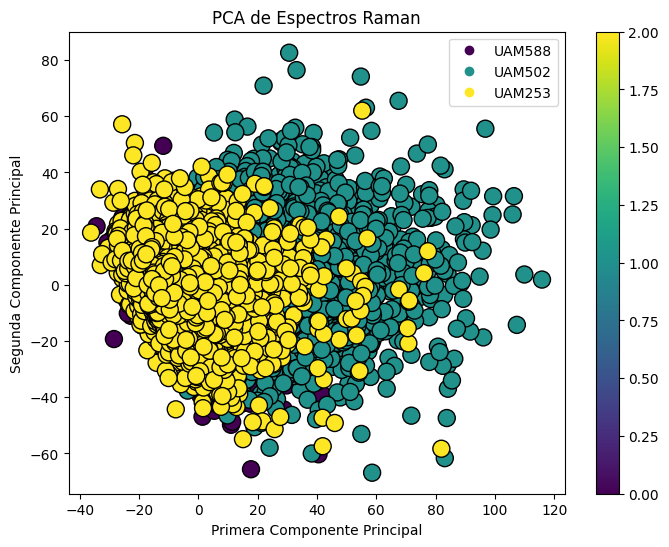

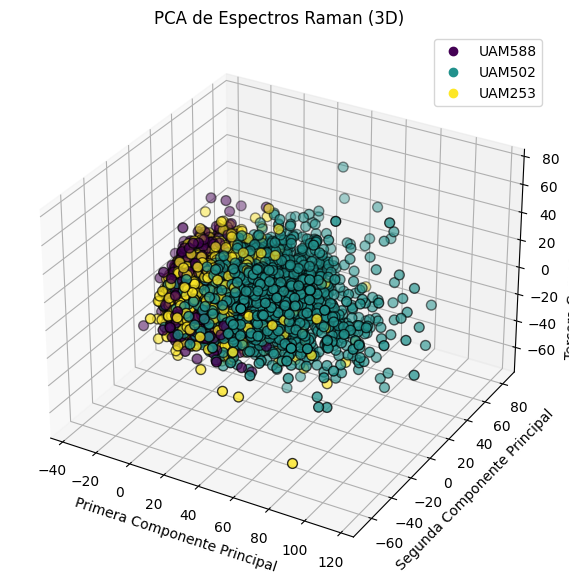

Varianza explicada por cada componente principal: [0.25373866 0.13155153 0.0925697 ]


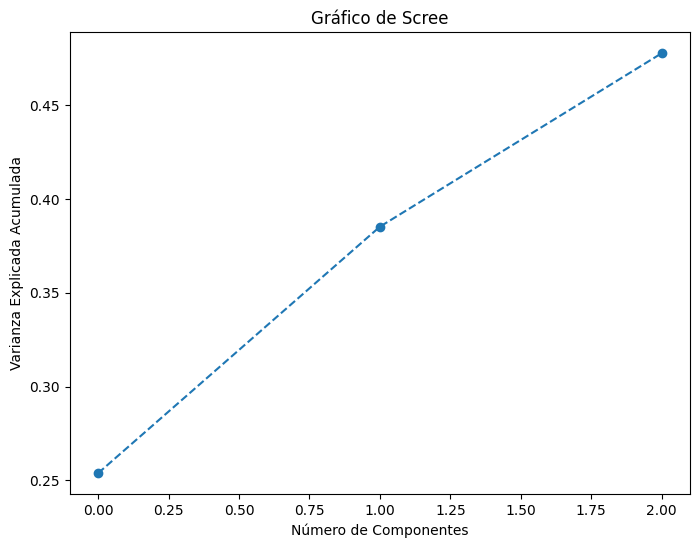

In [78]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

labels_588 = np.zeros(UAM588.shape[0])
labels_502 = np.ones(UAM502.shape[0])
labels_253 = np.full(UAM253.shape[0], 2)

# Combinar los datos y las etiquetas
X = pd.concat([UAM588, UAM502, UAM253], ignore_index=True)
y = np.hstack((labels_588, labels_502, labels_253))

# Estandarizar los datos
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Aplicar PCA con 3 componentes
pca = PCA(n_components=3)
X_pca = pca.fit_transform(X_scaled)

# Visualizar los resultados en 2D
plt.figure(figsize=(8, 6))
scatter = plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y, cmap='viridis', edgecolor='k', s=150)
plt.xlabel('Primera Componente Principal')
plt.ylabel('Segunda Componente Principal')
plt.title('PCA de Espectros Raman')
plt.legend(handles=scatter.legend_elements()[0], labels=['UAM588', 'UAM502', 'UAM253'])
plt.colorbar()
plt.show()

# Visualizar los resultados en 3D
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')
scatter = ax.scatter(X_pca[:, 0], X_pca[:, 1], X_pca[:, 2], c=y, cmap='viridis', edgecolor='k', s=50)
ax.set_xlabel('Primera Componente Principal')
ax.set_ylabel('Segunda Componente Principal')
ax.set_zlabel('Tercera Componente Principal')
plt.title('PCA de Espectros Raman (3D)')
plt.legend(handles=scatter.legend_elements()[0], labels=['UAM588', 'UAM502', 'UAM253'])
plt.show()

# Varianza explicada
explained_variance = pca.explained_variance_ratio_
print("Varianza explicada por cada componente principal:", explained_variance)

# Gráfico de Scree
plt.figure(figsize=(8, 6))
plt.plot(np.cumsum(pca.explained_variance_ratio_), marker='o', linestyle='--')
plt.xlabel('Número de Componentes')
plt.ylabel('Varianza Explicada Acumulada')
plt.title('Gráfico de Scree')
plt.show()

Precisión: 0.93
              precision    recall  f1-score   support

      UAM253       0.94      0.97      0.96      1633
      UAM502       0.93      0.90      0.91       929
      UAM588       0.93      0.89      0.91       646

    accuracy                           0.93      3208
   macro avg       0.93      0.92      0.93      3208
weighted avg       0.93      0.93      0.93      3208

[[1587   31   15]
 [  62  838   29]
 [  38   34  574]]
Importancia de las características:
1. 1540: 0.0298
2. 1510: 0.0164
3. 1513: 0.0161
4. 1534: 0.0151
5. 1541: 0.0145
6. 1542: 0.0139
7. 1791: 0.0129
8. 1505: 0.0129
9. 1789: 0.0126
10. 1528: 0.0126
11. 1774: 0.0123
12. 1773: 0.0114
13. 1531: 0.0112
14. 1538: 0.0111
15. 1787: 0.0110
16. 1169: 0.0109
17. 1511: 0.0105
18. 1529: 0.0104
19. 1536: 0.0100
20. 1537: 0.0095
21. 1508: 0.0095
22. 1788: 0.0090
23. 1530: 0.0087
24. 1785: 0.0083
25. 1775: 0.0081
26. 1535: 0.0077
27. 1783: 0.0074
28. 1543: 0.0074
29. 1790: 0.0073
30. 1759: 0.0071
31. 1795: 0

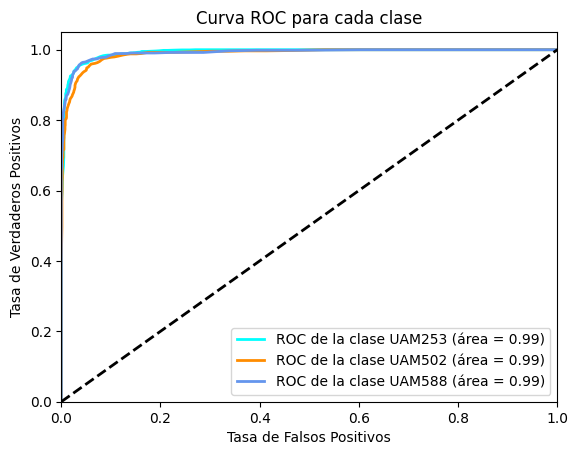

In [79]:
from sklearn.preprocessing import label_binarize
# Supongamos que tus DataFrames preprocesados ya están listos
# Añadimos una columna para indicar la especie



UAM588_2= UAM588.copy()
UAM502_2= UAM502.copy()
UAM253_2= UAM253.copy()
# Añadimos una columna para indicar la especie
UAM588_2['species'] = 'UAM588'
UAM502_2['species'] = 'UAM502'
UAM253_2['species'] = 'UAM253'
# Combinamos los DataFrames
data = pd.concat([UAM588_2, UAM502_2, UAM253_2], ignore_index=True)

# Convertimos las etiquetas de las especies a valores numéricos
label_encoder = LabelEncoder()
data['species'] = label_encoder.fit_transform(data['species'])

# Separar características y etiquetas
X = data.drop(columns=['species'])
y = data['species']

# Dividir en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Crear el modelo Random Forest
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)

# Entrenar el modelo
rf_model.fit(X_train, y_train)

# Hacer predicciones en el conjunto de prueba
y_pred = rf_model.predict(X_test)
y_prob = rf_model.predict_proba(X_test)  # Probabilidades para la curva ROC

# Calcular la precisión del modelo
accuracy = accuracy_score(y_test, y_pred)
print(f'Precisión: {accuracy:.2f}')

# Mostrar el informe de clasificación
print(classification_report(y_test, y_pred, target_names=label_encoder.classes_))

# Mostrar la matriz de confusión
print(confusion_matrix(y_test, y_pred))

# Importancia de las características
importances = rf_model.feature_importances_
indices = np.argsort(importances)[::-1]
feature_names = X.columns

print("Importancia de las características:")
for f in range(X.shape[1]):
    print(f"{f + 1}. {feature_names[indices[f]]}: {importances[indices[f]]:.4f}")

# Curva ROC para múltiples clases
# Binarizamos las etiquetas
y_test_bin = label_binarize(y_test, classes=[0, 1, 2])
n_classes = y_test_bin.shape[1]

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], y_prob[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(y_test_bin.ravel(), y_prob.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Plot ROC curve for each class
plt.figure()
colors = ['aqua', 'darkorange', 'cornflowerblue']
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'ROC de la clase {label_encoder.classes_[i]} (área = {roc_auc[i]:.2f})')

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('Tasa de Falsos Positivos')
plt.ylabel('Tasa de Verdaderos Positivos')
plt.title('Curva ROC para cada clase')
plt.legend(loc="lower right")
plt.show()

In [80]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import confusion_matrix, classification_report
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.utils import to_categorical



# Convertir las etiquetas a formato categórico (one-hot encoding)
y_categorical = to_categorical(y, num_classes=3)

# Dividir los datos escalados en conjunto de entrenamiento y prueba
X_train_scaled, X_test_scaled, y_train, y_test = train_test_split(X_scaled, y_categorical, test_size=0.2, random_state=42)

# Inicializar la red neuronal
model = Sequential([
    Dense(64, activation='relu', input_shape=(X_train_scaled.shape[1],)),
    Dense(32, activation='relu'),
    Dense(3, activation='softmax')  # Cambiar a softmax para clasificación multiclase
])

# Compilar el modelo
model.compile(optimizer='adam',
              loss='categorical_crossentropy',  # Cambiar a categorical_crossentropy
              metrics=['accuracy'])

# Entrenar el modelo
model.fit(X_train_scaled, y_train, epochs=50, batch_size=32, validation_split=0.2, verbose=1)

# Evaluar el modelo en el conjunto de prueba
y_pred_nn = np.argmax(model.predict(X_test_scaled), axis=1)
y_test_true = np.argmax(y_test, axis=1)

# Mostrar métricas de evaluación
print("\nResultados de la Red Neuronal:")
print(confusion_matrix(y_test_true, y_pred_nn))
print(classification_report(y_test_true, y_pred_nn))


Epoch 1/50
321/321 [==============================] - 3s 5ms/step - loss: 0.2151 - accuracy: 0.9259 - val_loss: 0.1692 - val_accuracy: 0.9451
Epoch 2/50
321/321 [==============================] - 1s 3ms/step - loss: 0.1083 - accuracy: 0.9622 - val_loss: 0.1186 - val_accuracy: 0.9606
Epoch 3/50
321/321 [==============================] - 1s 4ms/step - loss: 0.0819 - accuracy: 0.9699 - val_loss: 0.1383 - val_accuracy: 0.9552
Epoch 4/50
321/321 [==============================] - 1s 4ms/step - loss: 0.0701 - accuracy: 0.9756 - val_loss: 0.1600 - val_accuracy: 0.9478
Epoch 5/50
321/321 [==============================] - 1s 3ms/step - loss: 0.0522 - accuracy: 0.9817 - val_loss: 0.1121 - val_accuracy: 0.9634
Epoch 6/50
321/321 [==============================] - 1s 4ms/step - loss: 0.0417 - accuracy: 0.9842 - val_loss: 0.1722 - val_accuracy: 0.9447
Epoch 7/50
321/321 [==============================] - 1s 4ms/step - loss: 0.0387 - accuracy: 0.9867 - val_loss: 0.1553 - val_accuracy: 0.9622
Epoch 

In [81]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.metrics import confusion_matrix, classification_report







# Dividir los datos en conjunto de entrenamiento y prueba
X_train_scaled, X_test_scaled, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# Inicializar el clasificador SVM para un problema multiclase
svm_classifier = SVC(kernel='rbf', gamma='scale', random_state=42)

# Entrenar el modelo SVM
svm_classifier.fit(X_train_scaled, y_train)

# Predecir en el conjunto de prueba
y_pred_svm = svm_classifier.predict(X_test_scaled)

# Evaluar el modelo SVM
print("\nResultados SVM:")
print(confusion_matrix(y_test, y_pred_svm))
print(classification_report(y_test, y_pred_svm))



Resultados SVM:
[[1602   22    9]
 [  26  893   10]
 [  15   25  606]]
              precision    recall  f1-score   support

           0       0.98      0.98      0.98      1633
           1       0.95      0.96      0.96       929
           2       0.97      0.94      0.95       646

    accuracy                           0.97      3208
   macro avg       0.96      0.96      0.96      3208
weighted avg       0.97      0.97      0.97      3208



In [82]:
UAM588.to_csv('UAM588.csv', index=False)
UAM502.to_csv('UAM502.csv', index=False)
UAM253.to_csv('UAM253.csv', index=False)


